# Downstream spatial analysis 01

This notebook performs the following downstream analyses, starting with the adata object generated in [00_downstream_analysis.ipynb](00_downstream_analysis.ipynb)
- Squidy interaction scoring 
- DE testing
- Establish distance from TLS and bronchi axes and quantify variation along these axes


In [1]:
import sys
import os
import time
import warnings
import re
import math
import hisepy as hp

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import anndata
import scanpy as sc
import squidpy as sq


import scipy
from scipy.spatial import distance_matrix
from scipy.spatial.distance import cdist
from scipy import stats
import scipy.ndimage as ndi
from scipy.stats import gaussian_kde
from scipy.ndimage import gaussian_filter
from scipy.signal import find_peaks

from shapely.geometry import Point

sys.version_info

sys.version_info(major=3, minor=12, micro=2, releaselevel='final', serial=0)

In [2]:
import random
import matplotlib.colors as mcolors

In [3]:
import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 24
mpl.rcParams['pdf.fonttype'] = 42

In [4]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PowerTransformer

In [5]:
from shapely.geometry import MultiPolygon
from alphashape import alphashape
from alphashape import optimizealpha
import geopandas as gpd

import pickle
import joblib

In [6]:
import warnings
warnings.simplefilter(action='ignore', category=Warning)

In [7]:
import matplotlib.colors as clr
import colorcet

zissou = [
    "#3A9AB2",
    "#6FB2C1",
    "#91BAB6",
    "#A5C2A3",
    "#BDC881",
    "#DCCB4E",
    "#E3B710",
    "#E79805",
    "#EC7A05",
    "#EF5703",
    "#F11B00",
]

colormap = clr.LinearSegmentedColormap.from_list("Zissou", zissou)
colormap_r = clr.LinearSegmentedColormap.from_list("Zissou", zissou[::-1])

## Active environment:

In [8]:
print('active conda environment: ', os.path.basename(sys.prefix))

active conda environment:  space2


## Local file info

In [9]:
dist_out_dir = '/home/workspace/spatial_mouse_lung_outputs/downstream_analysis/distance'

if not os.path.exists (dist_out_dir):
    os.makedirs(dist_out_dir)

plot_out_dir = os.path.join(dist_out_dir, 'plots')
if not os.path.exists (plot_out_dir):
    os.makedirs(plot_out_dir)

## Load adata

In [10]:
xen_filepath = os.path.join(dist_out_dir,'adata_distance.h5ad')
adata = sc.read_h5ad(xen_filepath)

## Plotting functions

In [10]:
def zone_composition(adata, label_col, zone_col, zones_labels = None, remove_unlabeled = False, save_path = False, palette_map = None, plot_counts = False):
    """
    Plot stacked bar charts showing the composition of cell labels within each spatial zone.

    This function groups cells by a spatial zone column and a label column (e.g., cell type), 
    calculates either the count or fraction of each label in each zone, and visualizes the result 
    as a stacked bar chart (horizontal or vertical).
    """
    
    plt.rcParams.update({'font.size': 14})

    if palette_map is not None:
        palette = palette_map
    else:
        palette = sns.color_palette(colorcet.glasbey_dark, 
                                n_colors=len(adata.obs[label_col].unique().tolist())
                               )

    if remove_unlabeled:
        adata = adata[adata.obs[label_col]!='unlabeled', :]

    # adata.obs[zone_col] = adata.obs[zone_col].astype(int)
    
    summary_df = adata.obs.groupby([zone_col, label_col]).size().reset_index(name='count')

    # Pivot the table to get 'zone' as rows, 'majority_voting' as columns, and 'count' as values
    summary_counts = pd.pivot_table(summary_df, values='count', index=zone_col, columns=label_col, fill_value=0)

    # calculate fractions
    row_sums= summary_counts.sum(axis=1)
    summary_frac = summary_counts.div(row_sums, axis=0)   
    
    if plot_counts:
        ax1 = summary_counts.plot.bar(stacked=True, color = palette, rot=0)
        ax1.legend(bbox_to_anchor=(1.8, 1), loc='upper right', fontsize =12, ncol=2, frameon=True, framealpha=0, edgecolor='black',
                   handletextpad=0.5,  # Reduce space between legend markers and text
                    columnspacing=0.8)  # Reduce space between columns
        ax1.set_title('')
        ax1.set_xlabel('')

    else:
        # plot fractions
        ax1 = summary_frac.plot.bar(stacked=True, color = palette, rot=0)
        ax1.legend(bbox_to_anchor=(1.8, 1), loc='upper right', fontsize =12, ncol=2, frameon=True, framealpha=0, edgecolor='black',
                   handletextpad=0.5,  # Reduce space between legend markers and text
                    columnspacing=0.8)  # Reduce space between columns
        ax1.set_title('')
        ax1.set_xlabel('')


        
    
    if zones_labels is not None:
        ax1.set_xticklabels(zones_labels)
        
    return ax1

In [11]:
def zone_composition_heatmap(adata, label_col, zone_col, swap_axes = False, save_path=None):
    """
    Plot a heatmap showing the normalized composition of cell labels within each spatial zone.

    This function summarizes the number of cells per (zone, label) combination,
    normalizes the values to fractions within each zone, then scales them to [0, 1] 
    across labels for visualization.
    """
    
    summary_df = adata.obs.groupby([zone_col, label_col]).size().reset_index(name='count')

    # Pivot the table to get 'zone' as rows, 'majority_voting' as columns, and 'count' as values
    summary_counts = pd.pivot_table(summary_df, values='count', index=zone_col, columns=label_col, fill_value=0)

    # calculate fractions
    row_sums= summary_counts.sum(axis=1)
    summary_frac = summary_counts.div(row_sums, axis=0)  
    del summary_frac['unknown']

    scaler = MinMaxScaler()
    summary_frac_scaled = scaler.fit_transform(summary_frac.T).T

    if swap_axes:
        print('swap')
        summary_frac_scaled = summary_frac_scaled.T
        xticklabels=summary_frac.index
        yticklabels=summary_frac.columns
        fig, ax = plt.subplots(1, 1, figsize=(2, 6))
    else:

        xticklabels=summary_frac.columns
        yticklabels=summary_frac.index
        fig, ax = plt.subplots(1, 1, figsize=(8, 1.5))
        
    
    
    # fig, ax = plt.subplots(1, 1, figsize=(10, 1))
    sns.heatmap(
        summary_frac_scaled,
        xticklabels=xticklabels,
        yticklabels=yticklabels,
        ax=ax,
        cmap=colormap,
        linecolor="white",
        linewidths=0.5,
    )
    ax.tick_params(axis='x', labelsize=14)

    if save_path is not None:
        fig.savefig(save_path, dpi=300, bbox_inches='tight', transparent=True)
    return(summary_frac_scaled)
    

## Load palettes

In [12]:
with open(os.path.join(dist_out_dir, '20250519_celltype_palette_mapped.pkl'), 'rb') as f:
    celltype_palette_mapped = pickle.load(f)

with open(os.path.join(dist_out_dir, '20250520_celltype_palette_coarse_mapped.pkl'), 'rb') as f:
    celltype_palette_coarse_mapped = pickle.load(f)

with open(os.path.join(dist_out_dir, '20250520_celltype_palette_coarser_mapped.pkl'), 'rb') as f:
    celltype_palette_coarser_mapped = pickle.load(f)

with open(os.path.join(dist_out_dir, '20250521_zone_consol_palette_mapped.pkl'), 'rb') as f:
    zone_consol_palette_mapped = pickle.load(f)

# Zone comparisons 

## Interaction score zone comparison 

In [14]:
# Run this analysis on adata_HDM the 3 zones of interest
# Make a new label column that is same as label_fine, but all activated CD4s are grouped
adata_int = adata[adata.obs['sample_label'] == 'HDM_day3', :].copy()

In [15]:
adata_int.obs['label_for_int'] = adata_int.obs['label_fine'].copy()
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('Th0', 'CD4 act')
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('Th1', 'CD4 act')
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('Th17', 'CD4 act')
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('Th2', 'CD4 act')
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('Treg', 'CD4 act')
adata_int.obs['label_for_int'] = adata_int.obs['label_for_int'].replace('CD4 trans', 'CD4 act')

In [16]:
adata_int_TLS = adata_int[adata_int.obs['zone_consol']=='TLS', :]
adata_int_TLSsmall = adata_int[adata_int.obs['zone_consol']=='TLS-small', :]
adata_int_adventitia = adata_int[adata_int.obs['zone_consol']=='adventitia', :]
adata_int_parenchyma = adata_int[adata_int.obs['zone_consol']=='parenchyma', :]
print(adata_int_TLS.shape)
print(adata_int_adventitia.shape)
print(adata_int_parenchyma.shape)

(9321, 480)
(46023, 480)
(251594, 480)


In [17]:
print(adata_int_TLS[adata_int_TLS.obs['label_for_int']=='CD4 act', :].shape)
print(adata_int_TLSsmall[adata_int_TLSsmall.obs['label_for_int']=='CD4 act', :].shape)
print(adata_int_adventitia[adata_int_adventitia.obs['label_for_int']=='CD4 act', :].shape)
print(adata_int_parenchyma[adata_int_parenchyma.obs['label_for_int']=='CD4 act', :].shape)

(610, 480)
(590, 480)
(1384, 480)
(5918, 480)


### Run squidpy interaction scoring

In [18]:
for adata_subset in [adata_int_TLS, adata_int_TLSsmall, adata_int_adventitia, adata_int_parenchyma]:
    sq.gr.spatial_neighbors(adata_subset, coord_type="generic", delaunay=True, key_added= 'spatial_new')
    sq.gr.interaction_matrix(adata_subset, cluster_key="label_for_int", connectivity_key = 'spatial_new', 
                                        normalized=True)

### Visualize interaction differences between zones

In [19]:
labels_TLS  = adata_int_TLS.obs['label_for_int'].cat.categories
z_TLS = pd.DataFrame(
    adata_int_TLS.uns['label_for_int_interactions'],
    index=labels_TLS, columns=labels_TLS
)

labels_TLSsmall  = adata_int_TLSsmall.obs['label_for_int'].cat.categories
z_TLSsmall = pd.DataFrame(
    adata_int_TLSsmall.uns['label_for_int_interactions'],
    index=labels_TLSsmall, columns=labels_TLSsmall
)

labels_adventitia  = adata_int_adventitia.obs['label_for_int'].cat.categories
z_adventitia = pd.DataFrame(
    adata_int_adventitia.uns['label_for_int_interactions'],
    index=labels_adventitia, columns=labels_adventitia
)

labels_parenchyma  = adata_int_parenchyma.obs['label_for_int'].cat.categories
z_parenchyma = pd.DataFrame(
    adata_int_parenchyma.uns['label_for_int_interactions'],
    index=labels_parenchyma, columns=labels_parenchyma
)

# confirm all cell types included in each
print(z_TLS.shape)
print(z_TLSsmall.shape)
print(z_adventitia.shape)
print(z_parenchyma.shape)

(26, 26)
(32, 32)
(32, 32)
(32, 32)


In [20]:
ordered_cols = z_parenchyma.columns
ordered_cols

Index(['AT1', 'AT2', 'Club', 'Ciliated', 'SMC', 'Col13a1+ fibroblast',
       'Col14a1+ fibroblast', 'Myofibroblast', 'Pericyte 1', 'Pericyte 2',
       'Mesothelial', 'Cap', 'Cap-a', 'Art', 'Vein', 'Lymph', 'Mono', 'Int Mf',
       'Alv Mf', 'Neut', 'cDC1', 'Ccr7- cDC2', 'Ccr7+ cDC2', 'B cell',
       'Plasmablast', 'NK cell', 'gd T cell', 'ILC2', 'CD8 naive', 'CD8 act',
       'CD4 naive', 'CD4 act'],
      dtype='object')

In [21]:
row_TLS = z_TLS.loc['CD4 act'].reindex(ordered_cols)
row_TLS

AT1                         NaN
AT2                         NaN
Club                        NaN
Ciliated                    NaN
SMC                    0.000811
Col13a1+ fibroblast    0.005408
Col14a1+ fibroblast    0.032180
Myofibroblast          0.000270
Pericyte 1             0.009735
Pericyte 2             0.001352
Mesothelial                 NaN
Cap                    0.001622
Cap-a                       NaN
Art                    0.000000
Vein                   0.002163
Lymph                  0.013521
Mono                   0.003786
Int Mf                 0.055976
Alv Mf                 0.010005
Neut                   0.007301
cDC1                   0.013250
Ccr7- cDC2             0.018388
Ccr7+ cDC2             0.012710
B cell                 0.564089
Plasmablast            0.045700
NK cell                0.000811
gd T cell              0.087074
ILC2                   0.000270
CD8 naive              0.000270
CD8 act                0.014602
CD4 naive              0.004056
CD4 act 

In [22]:
# Use z_TLS.columns as the master column order
ordered_cols = z_parenchyma.columns

# Reindex each row to match the full column set and preserve order
row_TLS = z_TLS.loc['CD4 act'].reindex(ordered_cols)
row_TLSsmall = z_TLSsmall.loc['CD4 act'].reindex(ordered_cols)
row_adventitia = z_adventitia.loc['CD4 act'].reindex(ordered_cols)
row_parenchyma = z_parenchyma.loc['CD4 act'].reindex(ordered_cols)

# Stack into a DataFrame
int_summary = pd.DataFrame([row_TLS, row_TLSsmall, row_adventitia, row_parenchyma])
int_summary.index = ['TLS', 'TLS-small', 'adventitia', 'parenchyma']


In [23]:
print(int_summary.max(axis=1))
print(int_summary.idxmax(axis=1))

TLS           0.564089
TLS-small     0.272648
adventitia    0.129369
parenchyma    0.177460
dtype: float64
TLS           B cell
TLS-small     B cell
adventitia    Int Mf
parenchyma       Cap
dtype: object


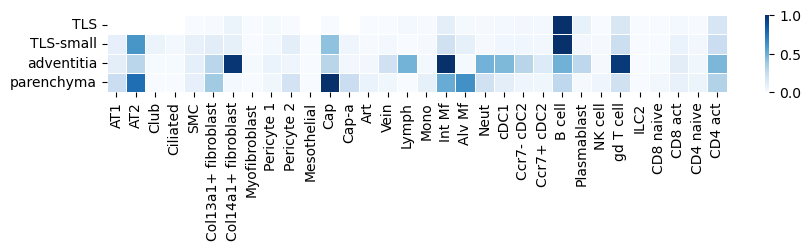

In [25]:
# Scale each row from min to max
scaler = MinMaxScaler()
int_summary_scaled = scaler.fit_transform(int_summary.T).T

xticklabels = list(ordered_cols)

fig, ax = plt.subplots(1, 1, figsize=(10, 1))
sns.heatmap(
    int_summary_scaled,
    xticklabels=xticklabels,
    yticklabels=['TLS', 'TLS-small', 'adventitia', 'parenchyma'],
    ax=ax,
    cmap='Blues',
    linecolor="white",
    linewidths=0.5,
)

fig.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_interactions_CD4act_allcells.png"), dpi=300, bbox_inches='tight', transparent=True)
fig.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_interactions_CD4act_allcells.pdf"), dpi=300, bbox_inches='tight', transparent=True)

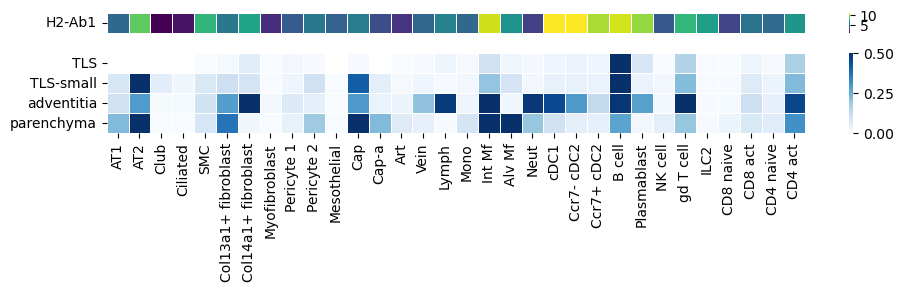

In [26]:
# 1. Scale interaction matrix
scaler = MinMaxScaler()
int_summary_scaled = scaler.fit_transform(int_summary.T).T
xticklabels = list(ordered_cols)
yticklabels_top = ['TLS', 'TLS-small', 'adventitia', 'parenchyma']

# 2. Extract matrixplot-like gene expression data
adata_gene = adata_int[:, ['H2-Ab1']]
gene_expr_df = pd.DataFrame(
    adata_gene.X.toarray() if hasattr(adata_gene.X, "toarray") else adata_gene.X,
    index=adata_gene.obs['label_for_int'],
    columns=adata_gene.var_names
)

# Average per label
gene_matrix = gene_expr_df.groupby(level=0).mean().T.reindex(columns=xticklabels).fillna(0)

# 3. Create stacked heatmap figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 3), height_ratios=[1,4], sharex=True)

# Top: expression of H2-Ab1
sns.heatmap(
    gene_matrix,
    xticklabels=xticklabels,
    yticklabels=['H2-Ab1'],
    ax=ax1,
    cmap='viridis',
    linecolor="white",
    linewidths=0.5,
)
ax1.set_xlabel('')
ax1.tick_params(axis='x', bottom=False, top=False)
ax1.tick_params(axis='x')
ax1.tick_params(axis='y', rotation=0)

# bottom: interaction scores
sns.heatmap(
    int_summary_scaled,
    xticklabels=xticklabels,
    yticklabels=yticklabels_top,
    ax=ax2,
    cmap='Blues',
    vmax=.5,
    linecolor="white",
    linewidths=0.5
)
ax2.set_xlabel('')
ax2.tick_params(axis='x', rotation=90)

plt.tight_layout()

fig.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_interactions_CD4act_allcells_vmax_H2Ab1.png"), dpi=300, bbox_inches='tight', transparent=True)
fig.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_interactions_CD4act_allcells_vmax_H2Ab1.pdf"), dpi=300, bbox_inches='tight', transparent=True)

## CD4 DE between zones

In [88]:
def filter_adata_expressed_in_n_cells(adata, percent=0.05):
    """
    Filter the adata to only include genes expressed in more than a certain percentage of cells

    Parameters:
    - adata (anndata): The anndata object containing the gene expression
    - percent (float): The percentage of cells a gene must be expressed in to be included

    Return:
    - adata (anndata): The filtered anndata object
    """
    adata = adata.copy()
    adata.layers["bin"] = adata.X > 0
    gene_expressed_in_percent_cells = np.mean(adata.layers["bin"], axis=0)
    keep = gene_expressed_in_percent_cells > percent
    adata = adata[:, keep]
    return adata
    



In [101]:
def DE_test(adata, cell_column, cell_list=None, groupby=None, groups = 'all', reference= 'rest', stat_method = 'wilcoxon', use_raw = False, expression_threshold=None):
    """
    Performs differential expression (DE) testing on an AnnData object using Scanpy's `rank_genes_groups`.

    Parameters:
        adata (AnnData): The input AnnData object.
        cell_column (str): Column in `adata.obs` used to filter cells by type.
        cell_list (list, optional): List of cell types to subset before DE testing. If None, all cells are used.
        groupby (str): Column in `adata.obs` used to define groups for DE testing.
        groups (str or list, optional): Groups to test. Default is 'all'.
        reference (str, optional): Reference group for comparison. Default is 'rest'.
        stat_method (str, optional): Statistical test to use. 
        use_raw (bool, optional): Whether to use `.raw` for DE testing. Default is False.
        expression_threshold (float, optional): If set, filters genes to only those expressed in at least this percentage of cells.

    Returns:
        AnnData: A subsetted copy of the input `AnnData` object with DE results stored in `adata.uns['rank_genes_groups']`.
    """
    
    if cell_list:
        print('subsetting by celltype')
        adata_sub = adata[adata.obs[cell_column].isin(cell_list), :]
    else:
        print('not subsetting by cell type')
        adata_sub = adata.copy()
        
    # Optionally to include only genes that are expressed in 5% of the cells
    if expression_threshold:
        print('removing genes by expression threshold: ', expression_threshold, ' %')
        adata_sub=filter_adata_expressed_in_n_cells(adata_sub,percent=expression_threshold)
              
    sc.tl.rank_genes_groups(adata_sub, groupby, method=stat_method, corr_method='benjamini-hochberg', groups=groups, reference= reference, use_raw=use_raw)
    return(adata_sub)

In [102]:
from adjustText import adjust_text  # Import adjustText for text repel

def DE_volcano(df_DEG, p_column, n_column, lfc_column, lfc_threshold = 1, genes_to_label = set(), 
               down_color = 'darkblue', up_color = 'darkred', title = ''):
    """
    Generates a volcano plot to visualize differential expression results.

    Parameters:
        df_DEG (pd.DataFrame): DataFrame containing gene-level DE results.
        p_column (str): Name of the column with p-values.
        n_column (str): Name of the column with gene names.
        lfc_column (str): Name of the column with log2 fold changes.
        lfc_threshold (float, optional): Threshold for log2 fold change significance. Default is 1.
        genes_to_label (set, optional): Set of gene names to force labeling in the plot.
        down_color (str, optional): Color for significantly downregulated genes. Default is 'darkblue'.
        up_color (str, optional): Color for significantly upregulated genes. Default is 'darkred'.
        title (str, optional): Title of the plot.

    Returns:
        matplotlib.figure.Figure: The generated volcano plot figure.
    """
    
    df_DEG = df_DEG.copy()

    # Avoid log(0) issue
    df_DEG[p_column] = df_DEG[p_column].replace(0, 1e-300)  
    # df_DEG = df_DEG.replace([np.inf, -np.inf], np.nan).dropna(subset=[p_column, lfc_column])
    
    df_DEG['-log10p'] = -np.log10(df_DEG[p_column])    
    
    # Create the volcano plot
    plt.figure(figsize=(8, 6))

    # label all significant genes
    if len(genes_to_label) > 0:
        print('adding to provided genes to label list')
    else:
        print('labeling genes by adj p val and lfc only')
        genes_to_label = set()
    
    # Define colors based on conditions
    colors = []
    for i, row in df_DEG.iterrows():
        if row[p_column] < 0.05 and row[lfc_column] < -lfc_threshold:
            colors.append(down_color)  # significantly downregulated
            genes_to_label.add(row[n_column])
        elif row[p_column] < 0.05 and row[lfc_column] > lfc_threshold:
            colors.append(up_color)  # significantly upregulated
            genes_to_label.add(row[n_column])
        else:
            colors.append('gray')  # nonsignificant
    
    # Limit x-axis values to the range -10 to 10, capping points beyond the limits
    lfc_max = max(abs(df_DEG[lfc_column]))*1.025
    capped_l = df_DEG[lfc_column].clip(-lfc_max, lfc_max)
    
    # Scatter plot for all points
    plt.scatter(capped_l, df_DEG['-log10p'], c=colors, s=20, zorder=1)
    
    # Add horizontal and vertical lines for significance thresholds
    plt.axhline(y=-np.log10(0.05), color='gray', linestyle='--', zorder=2)
    plt.axvline(x=lfc_threshold, color='gray', linestyle='--', zorder=2)
    plt.axvline(x=-lfc_threshold, color='gray', linestyle='--', zorder=2)
    
    # Highlight and label specific genes
    text_objects = [] 
    for i, row in df_DEG.iterrows():
        if row[n_column] in genes_to_label:
            x_position = min(max(row[lfc_column], -lfc_max), lfc_max)  # Ensure label position is within x-axis limits
            plt.scatter(x_position, row['-log10p'], c=colors[i], s=20, zorder=3)  # Bring to front with original color
            # plt.text(x_position, row['-log10p'], row[n_column], fontsize=8, zorder=4)
            text = plt.text(x_position, row['-log10p'], row[n_column], fontsize=10, zorder=4)
            text_objects.append(text)  # Store text for adjustment

    adjust_text(
        text_objects, 
        expand_points=(1.5, 1.5),  # Spread labels away from points
        expand_text=(1.2, 1.2),    # Spread labels away from each other
        force_text=(0.2, 0.5),     # Increase force between text labels
        force_points=(0.3, 0.5),   # Increase force between text and points
        lim=300,                   # Increase number of iterations
        arrowprops=dict(arrowstyle="-", color='black', lw=0.5)  # Keep arrows
    )
    
    plt.xlabel('log2 Fold Change')
    plt.ylabel('-log10(p-value)')
    plt.title(title)
    plt.xlim(-lfc_max, lfc_max)
    
    # plt.savefig(os.path.join(figure_folder, f"VolcanoPlot.pdf"), dpi=300, bbox_inches="tight")
    fig = plt.gcf()
    return(fig)

In [103]:
# CITE genes expressed in 5% of at least one subset
gene_df = pd.read_csv('/home/workspace/spatial_mouse_lung_outputs/cell_labeling/ouputs_mouselung_hurskainen_ref_consolidate_labels_xenseg_HDM/cite_integration/cite_expressed_genes_by_annotation.csv')
genes_cite_filt = gene_df['x'].tolist()

# Xenium genes expressed in 5% of at least one subset
genes_xen_filt = []
adata_cd4 = adata.copy()
for subset in adata_cd4.obs['label_fine'].unique().tolist():
    adata_cd4_subset = adata_cd4[adata_cd4.obs['label_fine'] == subset, :]
    adata_cd4_subset = filter_adata_expressed_in_n_cells(adata_cd4_subset, percent=0.05)
    genes_xen_filt.extend(adata_cd4_subset.var.index.tolist())
genes_xen_filt = list(set(genes_xen_filt))

# take the intersection and use this list for heatmaps 
genes_cite_xen_filt = list(set(genes_cite_filt) & set(genes_xen_filt))

In [104]:
sample_label = 'HDM_day3'
zone_col = 'zone_consol'
zone_order = ['TLS', 'TLS-small', 'adventitia', 'parenchyma']  


celltype_col = 'label_medium'
celltype = 'CD4 act'

adata_select = adata[adata.obs['sample_label']==sample_label, genes_cite_xen_filt]
adata_select = adata_select[adata_select.obs[celltype_col]==celltype, :]
adata_select = adata_select[adata_select.obs['zone_consol'].isin(zone_order), :]
print(adata_select.shape)

print(celltype)
adata_select = DE_test(adata_select, celltype_col, cell_list = [celltype], groupby = zone_col, groups = 'all', reference= 'rest',
                    stat_method = 'wilcoxon', use_raw = False)
    

(8502, 184)
CD4 act
subsetting by celltype


['CD4 act']
Categories (1, object): ['CD4 act']
unique deg before pval / lfc filter:  184
unique deg after pval / lfc filter:  57


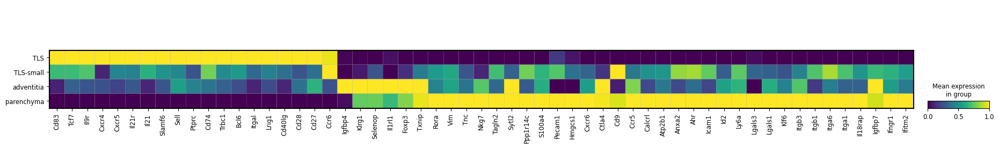

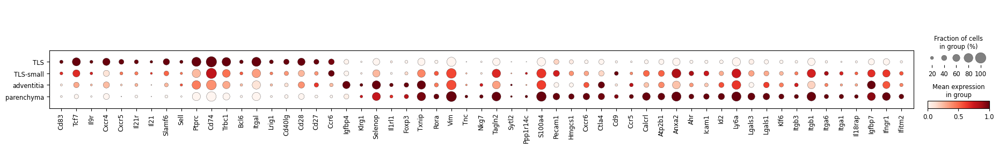

In [105]:
pval_adjs_cutoff = 0.05
lfc_cutoff = 1.5

print(adata_select.obs[celltype_col].unique())

# output df_DEG for each 
results = adata_select.uns['rank_genes_groups']
groups = results['names'].dtype.names

df_DEG_list = []
for group in groups: 
    # print(group)
    df_DEG = pd.DataFrame(
        {key: results[key][group]
         for key in ['names', 'logfoldchanges', 'pvals_adj']})
    df_DEG['group'] = group
    df_DEG_list.append(df_DEG)
    # volcano plot for each zone
    # fig = DE_volcano(df_DEG, 'pvals_adj', 'names', 'logfoldchanges', 
    #        title = group)
    # fig.savefig(os.path.join(plot_out_dir, f"HDM_day3_zone_DE_CD4_volcano{group}.png"), dpi=300, bbox_inches='tight', transparent=True)
    


df_DEG_concat = pd.concat(df_DEG_list, ignore_index=True)

# before filtering by pval or lfc, get group max lfc
df_DEG_concat_max_lfc = df_DEG_concat.loc[
    df_DEG_concat.groupby("names")["logfoldchanges"].idxmax()
]

df_DEG_concat_max_lfc_sorted = df_DEG_concat_max_lfc.sort_values(
    by="group", key=lambda x: x.map({zone: i for i, zone in enumerate(zone_order)})
)
unique_DEG_sorted = df_DEG_concat_max_lfc_sorted["names"].tolist()
print('unique deg before pval / lfc filter: ', len(unique_DEG_sorted))

# now filter main df by p val and lfc
df_DEG_concat_filt = df_DEG_concat[df_DEG_concat['pvals_adj']<pval_adjs_cutoff]
df_DEG_concat_filt = df_DEG_concat_filt[abs(df_DEG_concat_filt['logfoldchanges'])>lfc_cutoff]

# filter the sorted gene list
unique_DEG_sorted = [gene for gene in unique_DEG_sorted if gene in set(df_DEG_concat_filt['names'])]
print('unique deg after pval / lfc filter: ', len(unique_DEG_sorted))

# plot heatmap at zone level
plt.rcParams['figure.figsize'] = (5, 3)  # width, height in inches
sc.pl.matrixplot(adata_select, var_names = unique_DEG_sorted, groupby = zone_col,
                swap_axes=False,
                standard_scale='var',
                show=False)
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_DE_CD4_matrixplot.png"), dpi=300, bbox_inches='tight', transparent=True)
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_DE_CD4_matrixplot.pdf"), dpi=300, bbox_inches='tight', transparent=True)

sc.pl.dotplot(
    adata_select, 
    var_names=unique_DEG_sorted, 
    groupby='zone_consol', 
    # mean_only_expressed=True,
    swap_axes=False, 
    standard_scale="var",
    # show_gene_labels=True,
    show=False
)
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_DE_CD4_dotplot.png"), dpi=300, bbox_inches='tight', transparent=True)
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_zone_DE_CD4_dotplot.pdf"), dpi=300, bbox_inches='tight', transparent=True)

# df_DEG_concat.to_csv(os.path.join(dist_out_dir, "cd4_zone_deg.csv"))
df_DEG_concat.to_csv(os.path.join(dist_out_dir, "cd4_zone_deg.csv"))
cd4_zone_deg = unique_DEG_sorted

## All cell cytokine DE between zones

In [95]:
df_kegg_cytokines = pd.read_csv("/home/workspace/spatial_tls_manuscript/inputs/kegg_cytokines.csv")
df_kegg_cytokines = df_kegg_cytokines[df_kegg_cytokines["type"] == "ligand"]

all_cyto_genes = df_kegg_cytokines['gene'].tolist()

cyto_genes_panel = list(set(all_cyto_genes) & set(adata.var.index))
len(cyto_genes_panel)

41

In [96]:
sample_label = 'HDM_day3' 
zone_col = 'zone_consol'
zone_order = ['TLS', 'TLS-small', 'adventitia', 'parenchyma']  

celltype_col = 'label_medium'
celltype = 'CD4 act'

# adata_select = adata[adata.obs['sample_label']==sample_label, :]
adata_select = adata[adata.obs['sample_label']==sample_label, cyto_genes_panel]


adata_select = adata_select[:, cyto_genes_panel] # subset to cytokine genes 
adata_select = adata_select[adata_select.obs['zone_consol'].isin(zone_order), :]
print(adata_select.shape)

gene_filter_list = adata_select.var.index.tolist() # keep all genes for this analysis

adata_select = DE_test(adata_select, celltype_col, cell_list = None, groupby = zone_col, groups = 'all', reference= 'rest',  
                    stat_method = 'wilcoxon', use_raw = False, expression_threshold=0.05)
    

(321693, 41)
not subsetting by cell type
removing genes by expression threshold:  0.05  %


['CD4 naive', 'CD4 act', 'Mesenchymal', 'Alv Epi', 'Myeloid', ..., 'Endothelial', 'Innate Lymphoid', 'CD8 naive', 'CD8 act', 'Airwary Epi']
Length: 11
Categories (11, object): ['Alv Epi' < 'Airwary Epi' < 'Mesenchymal' < 'Endothelial' ... 'CD8 naive' < 'CD8 act' < 'CD4 naive' < 'CD4 act']
unique deg before pval / lfc filter:  14
unique deg after pval / lfc filter:  12


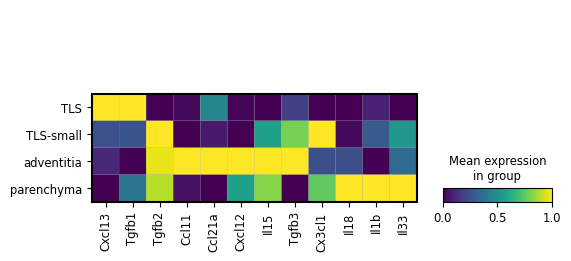

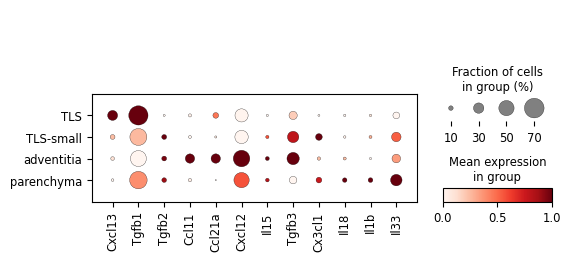

In [100]:
pval_adjs_cutoff = 0.05
lfc_cutoff = 1

print(adata_select.obs[celltype_col].unique())

# output df_DEG for each 
results = adata_select.uns['rank_genes_groups']
groups = results['names'].dtype.names

df_DEG_list = []
for group in groups: 
    # print(group)
    df_DEG = pd.DataFrame(
        {key: results[key][group]
         for key in ['names', 'logfoldchanges', 'pvals_adj']})
    df_DEG['group'] = group
    df_DEG_list.append(df_DEG)
    # volcano plot for each zone
    # fig = DE_volcano(df_DEG, 'pvals_adj', 'names', 'logfoldchanges', 
    #        title = group)
    # fig.savefig(os.path.join(plot_out_dir, f"HDM_cyto_zone_DE_volcano{group}.png"), dpi=300, bbox_inches='tight', transparent=True)
    


df_DEG_concat = pd.concat(df_DEG_list, ignore_index=True)

# before filtering by pval or lfc, get group max lfc
df_DEG_concat_max_lfc = df_DEG_concat.loc[
    df_DEG_concat.groupby("names")["logfoldchanges"].idxmax()
]

df_DEG_concat_max_lfc_sorted = df_DEG_concat_max_lfc.sort_values(
    by="group", key=lambda x: x.map({zone: i for i, zone in enumerate(zone_order)})
)
unique_DEG_sorted = df_DEG_concat_max_lfc_sorted["names"].tolist()
print('unique deg before pval / lfc filter: ', len(unique_DEG_sorted))

# now filter main df by p val and lfc
df_DEG_concat_filt = df_DEG_concat[df_DEG_concat['pvals_adj']<pval_adjs_cutoff]
df_DEG_concat_filt = df_DEG_concat_filt[abs(df_DEG_concat_filt['logfoldchanges'])>lfc_cutoff]

# filter the sorted gene list
unique_DEG_sorted = [gene for gene in unique_DEG_sorted if gene in set(df_DEG_concat_filt['names'])]
print('unique deg after pval / lfc filter: ', len(unique_DEG_sorted))

# plot heatmap at zone level
plt.rcParams['figure.figsize'] = (9, 3)  # width, height in inches
sc.pl.matrixplot(adata_select, var_names = unique_DEG_sorted, groupby = zone_col,
                swap_axes=False,
                standard_scale='var',
                show=False)
plt.savefig(os.path.join(plot_out_dir, "HDM_cyto_zone_DE_matrixplot.png"), dpi=300, bbox_inches='tight', transparent=True)
plt.savefig(os.path.join(plot_out_dir, "HDM_cyto_zone_DE_matrixplot.pdf"), dpi=300, bbox_inches='tight', transparent=True)

sc.pl.dotplot(
    adata_select, 
    var_names=unique_DEG_sorted, 
    groupby=zone_col, 
    mean_only_expressed=False,
    swap_axes=False, 
    standard_scale="var",
    show=False
)
plt.savefig(os.path.join(plot_out_dir, "HDM_cyto_zone_DE_dotplot.png"), dpi=300, bbox_inches='tight', transparent=True)
plt.savefig(os.path.join(plot_out_dir, "HDM_cyto_zone_DE_dotplot.pdf"), dpi=300, bbox_inches='tight', transparent=True)

# df_DEG_concat.to_csv(os.path.join(dist_out_dir, "allcell_cyto_zone_deg.csv"))
df_DEG_concat.to_csv(os.path.join(dist_out_dir, "allcell_cyto_zone_deg.csv"))
allcell_cyto_zone_deg = unique_DEG_sorted

In [76]:
df_DEG_concat_max_lfc

,names,logfoldchanges,pvals_adj,group
29,Ccl11,3.597844,0.000000e+00,adventitia
28,Ccl21a,5.850072,0.000000e+00,adventitia
32,Ccl5,0.562055,1.159923e-15,adventitia
44,Cx3cl1,1.056081,1.842405e-98,parenchyma
31,Cxcl12,0.931635,4.927355e-213,adventitia
0,Cxcl13,4.426094,0.000000e+00,TLS
15,Cxcl16,0.818286,2.164582e-57,TLS-small
34,Il15,0.238992,2.539681e-03,adventitia
45,Il18,1.250962,4.082602e-79,parenchyma
43,Il1b,1.735447,3.351495e-136,parenchyma


In [75]:
zone_order

['TLS', 'TLS-small', 'adventitia', 'parenchyma']

In [73]:
unique_DEG_sorted

['Cxcl13',
 'Tgfb1',
 'Tgfb2',
 'Ccl11',
 'Ccl21a',
 'Cxcl12',
 'Il15',
 'Tgfb3',
 'Cx3cl1',
 'Il18',
 'Il1b',
 'Il33']

# Distances
- Try two approaches:
- (1) distance to tls, bronchi, or vessel zone (not structure). Cells in zone = 0
- (2) distance to tls or bronchi structure

In [135]:
def cell_dist_to_zone(adata, cell_type_col, zone_col, zone_label, nearest_n, dist_col):
    
    # get coordinates of other cell type (the one we want to calculate the distance to)
    adata_other_type = adata[adata.obs[zone_col] == zone_label, :]
    zone_label_coords = adata_other_type.obs[['x_centroid', 'y_centroid']].values
    print('adata_other_type shape ', adata_other_type.shape)

    # first set all cells in adata with zone_col == zone_label to 0
    adata.obs.loc[adata.obs[zone_col] == zone_label, dist_col] = 0
    # now only calculate distances for other zones
    adata_other_zones = adata[adata.obs[zone_col] != zone_label, :]
    
    # Iterate over each unique cell type
    for cell_type in adata_other_zones.obs[cell_type_col].unique():

        # Filter AnnData object for the current cell type
        adata_filtered = adata_other_zones[adata_other_zones.obs[cell_type_col] == cell_type, :]
        adata_filtered_cell_type_indices = adata_filtered.obs.index
        # print('adata_cell_type shape ', adata_filtered.shape)
    
        # Get the coordinates of the cells of the current type
        cell_type_coords = adata_filtered.obs[['x_centroid', 'y_centroid']].values
        
        # Calculate the pairwise distances between the current cell type and other cell type
        pairwise_distances = cdist(cell_type_coords, zone_label_coords, metric='euclidean')
    
        # Sort distances and select nearest n
        nearest_distances = np.sort(pairwise_distances, axis=1)[:, :nearest_n]
        
        # Calculate the average distance to the nearest n cells
        avg_distance = np.mean(nearest_distances, axis=1)

        # Store distances in adata.obs 
        
        # Assigning values to the new column in the original DataFrame, using cell type filtered adata indices
        adata.obs.loc[adata_filtered_cell_type_indices, dist_col] = avg_distance

    return adata

In [136]:
import numpy as np
from shapely.geometry import Point, Polygon, MultiPolygon
from tqdm import  tqdm

def calculate_distances_to_regions(adata, dist_out_dir):
    """
    Calculate distances from each cell to the closest TLS and bronchi regions.
    Also determine if cells are inside these regions.
    
    Parameters
    ----------
    adata : AnnData
        The AnnData object containing spatial coordinates of cells
    dist_out_dir : str
        Directory where polygon files are stored
    
    Returns
    -------
    adata : AnnData
        Updated AnnData object with distance and boolean columns
    """
    # Create new columns in adata.obs for storing distances and boolean flags
    adata.obs['distance_to_tls'] = np.nan
    adata.obs['distance_to_bronchi'] = np.nan
    adata.obs['inside_tls'] = False
    adata.obs['inside_bronchi'] = False
    
    # Process each sample separately
    for sample_label in adata.obs['sample_label'].cat.categories:
        print(f"Processing sample: {sample_label}")
        
        # Get cells for current sample
        sample_mask = adata.obs['sample_label'] == sample_label
        
        # Load TLS polygons for this sample
        tls_poly_path = os.path.join(dist_out_dir, f'tls_poly_{sample_label}.pkl')
        tls_poly = joblib.load(tls_poly_path)
        
        # Load bronchi polygons for this sample
        bronchi_poly_path = os.path.join(dist_out_dir, f'bronchi_poly_{sample_label}.pkl')
        bronchi_poly = joblib.load(bronchi_poly_path)
        
        # Get spatial coordinates for cells in this sample
        coords = adata[sample_mask].obsm['spatial']
        
        # Calculate distances and check if cells are inside regions
        distances_to_tls = []
        distances_to_bronchi = []
        inside_tls_flags = []
        inside_bronchi_flags = []
        
        for i, (x, y) in tqdm(enumerate(coords), total=len(coords), desc=f"Processing {sample_label}", ncols=100):
            # Create point for current cell
            point = Point(x, y)
            
            # Check TLS regions
            min_dist_tls = float('inf')
            is_inside_tls = False
            
            # Handle potential MultiPolygon case
            if isinstance(tls_poly, MultiPolygon):
                tls_polygons = list(tls_poly.geoms)
            else:
                tls_polygons = [tls_poly]
                
            for poly in tls_polygons:
                # Check if point is inside polygon
                if poly.contains(point):
                    min_dist_tls = 0
                    is_inside_tls = True
                    break
                # Calculate distance to polygon if not inside
                dist = point.distance(poly)
                if dist < min_dist_tls:
                    min_dist_tls = dist
            
            # Check bronchi regions
            min_dist_bronchi = float('inf')
            is_inside_bronchi = False
            
            # Handle potential MultiPolygon case
            if isinstance(bronchi_poly, MultiPolygon):
                bronchi_polygons = list(bronchi_poly.geoms)
            else:
                bronchi_polygons = [bronchi_poly]
                
            for poly in bronchi_polygons:
                # Check if point is inside polygon
                if poly.contains(point):
                    min_dist_bronchi = 0
                    is_inside_bronchi = True
                    break
                # Calculate distance to polygon if not inside
                dist = point.distance(poly)
                if dist < min_dist_bronchi:
                    min_dist_bronchi = dist
            
            distances_to_tls.append(min_dist_tls)
            distances_to_bronchi.append(min_dist_bronchi)
            inside_tls_flags.append(is_inside_tls)
            inside_bronchi_flags.append(is_inside_bronchi)
        
        # Update AnnData object with calculated values for this sample
        adata.obs.loc[sample_mask, 'distance_to_tls'] = distances_to_tls
        adata.obs.loc[sample_mask, 'distance_to_bronchi'] = distances_to_bronchi
        adata.obs.loc[sample_mask, 'inside_tls'] = inside_tls_flags
        adata.obs.loc[sample_mask, 'inside_bronchi'] = inside_bronchi_flags
        
    return adata

In [ ]:
for zone_label in ['bronchi', 'vessels', 'TLS']:
    cell_type_col = 'label_fine'
    zone_col = 'zone_consol'
    dist_col = f'avg_distance_to_{zone_label}_zone'
    nearest_n = 10 
    
    start_time = time.time()
    
    adata.obs[dist_col] = np
    
    for sample_label in adata.obs['sample_label'].cat.categories:
        
        print(sample_label)
    
        adata_sample = adata[adata.obs['sample_label']==sample_label, :]
        
        # run distance calculation for each sample 
        adata_sample = cell_dist_to_zone(adata=adata_sample, 
                                                   cell_type_col=cell_type_col, 
                                                   zone_col=zone_col, 
                                                   zone_label=zone_label, 
                                                   nearest_n=nearest_n, 
                                                   dist_col=dist_col)
        
        # get distance df for each structure and add it back to the main adata object
        dist_df = adata_sample.obs[[dist_col]] 
        adata.obs.loc[dist_df.index, dist_col] = dist_df[dist_col]
    
    adata.obs[dist_col] = pd.to_numeric(adata.obs[dist_col])
    end_time = time.time()
    elapsed_time = (end_time - start_time) / 60
    print(elapsed_time, ' min')

calculate_distances_to_regions(adata, dist_out_dir)

adata.write_h5ad(os.path.join(dist_out_dir,'adata_distance_zones_structure.h5ad'), compression='gzip')

HDM_day3
adata_other_type shape  (16467, 480)


# Plot distances

In [13]:
adata = sc.read_h5ad(os.path.join(dist_out_dir,'adata_distance_zones_structure.h5ad'))

In [14]:
# matplotlib settings
plt.rcdefaults()
mpl.rcParams['pdf.fonttype'] = 42

In [15]:
import scvelo as scv
def scvelo_heatmap(
    adata: sc.AnnData,
    sample_label: list[str],
    sortby: str,
    key_name: str,
    key_value: str = None,
    highlight: list[str] = None,
    n_bins: int = 5,
    col_color = None, 
    x_clip = None,
    expression_threshold = None, 
    figsize: tuple = None 
):
    """
    Create a heatmap to visualize gene expression trends in single-cell RNA-seq data,
    with options for subsetting, sorting, and highlighting genes.

    Parameters:
    - adata (sc.AnnData): Annotated data object containing single-cell RNA-seq data.
    - sample_label (List[str]): List of batch identifiers to subset the data.
    - key_name (str): String representing the key in `adata.obs` to use for subsetting cells.
    - key_value (str): String representing the value of `key_name` to subset to.
    - sortby (str): Variable to sort the heatmap by (e.g., "crypt_villi_axis").
    - highlight (List[str]): List of labels to highlight on the heatmap.
    - n_bins (int, optional): Integer specifying the number of bins to use for convolution (default: 5).

    Returns:
    - s (seaborn.matrix.ClusterGrid): Matplotlib figure object representing the heatmap.

    This function subsets the input data based on specified sample_labels and key-value pairs,
    filters genes expressed in a minimum percentage of cells, and creates a heatmap
    to visualize gene expression trends along a specified variable. The function also allows
    highlighting specific labels on the y-axis.
    """
    print("Creating Heatmap for sample labels ", " + ".join(sample_label))

    # Subset sample_label
    adata = adata[adata.obs["sample_label"].isin(sample_label)]
    if key_value:
        print(f"Subset to '{key_name}'=='{key_value}'")
        # Subset to key
        adata = adata[adata.obs[key_name] == key_value]
    else:
        print("using all cells")
        
    # Filter to include only genes that are expressed in 5% of the cells
    if expression_threshold:
        print('removing genes by expression threshold: ', expression_threshold, ' %')
        adata=filter_adata_expressed_in_n_cells(adata,percent=expression_threshold)
    else:
        adata = adata.copy()
    print('adata shape: ', adata.shape)

    # Clip x axis
    if x_clip:
        print('clipping x to ', x_clip)
        adata = adata[adata.obs[sortby] <= x_clip, :]
        # adata.obs.loc[adata.obs[sortby] > x_clip, sortby] = x_clip
        
    n_convolve = len(adata) // n_bins
    print(f"Setting `n_convolve` to {n_convolve} ({n_bins} bins, {len(adata)} cells) ")
    # Plot
    s = scv.pl.heatmap(
        adata,
        var_names=adata.var_names,
        sortby=sortby,
        n_convolve=n_convolve,
        show=False,
        yticklabels=True,
        rasterized=True,
        # color_map=colormap,
        color_map='viridis',
        col_color = col_color,
        figsize=figsize
        
    )
    ax = s.ax_heatmap

    # Loop through the x-axis tick labels and show/hide based on the 'highlight' list
    if highlight:
        for i, label in enumerate(ax.get_yticklabels()):
            if label.get_text() not in highlight:
                label.set_visible(False)
                ax.get_yticklines()[2 * i + 1].set_visible(False)
            ax.get_yticklines()[2 * i].set_visible(False)
    else:
        # Make sure all labels and ticks are visible
        for label in ax.get_yticklabels():
            label.set_visible(True)
    
        for tickline in ax.get_yticklines():
            tickline.set_visible(False)  # optional: hide all tick lines
        

    ax.set_xlabel("")
    ax.set_title("")
    return s

## Separate by sample timepoint 

In [16]:
adata_d3 = adata[adata.obs['sample_label']=='HDM_day3', :]
adata_d30 = adata[adata.obs['sample_label']=='HDM_day30', :]

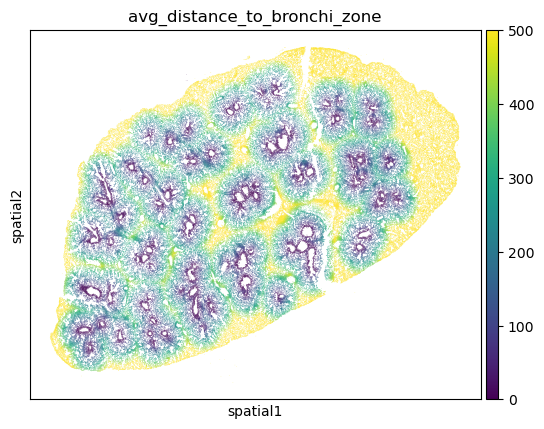

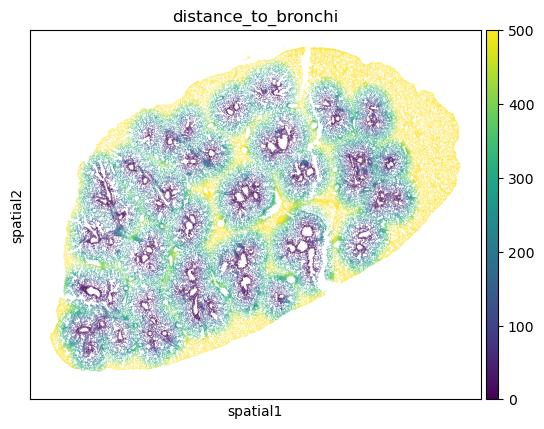

In [143]:
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'avg_distance_to_bronchi_zone',
               vmax = 500)
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'distance_to_bronchi',
               vmax = 500)

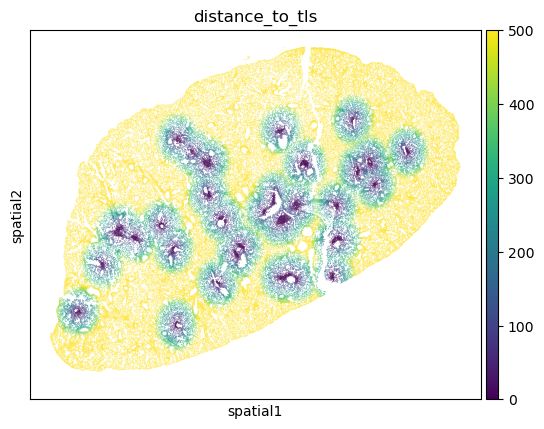

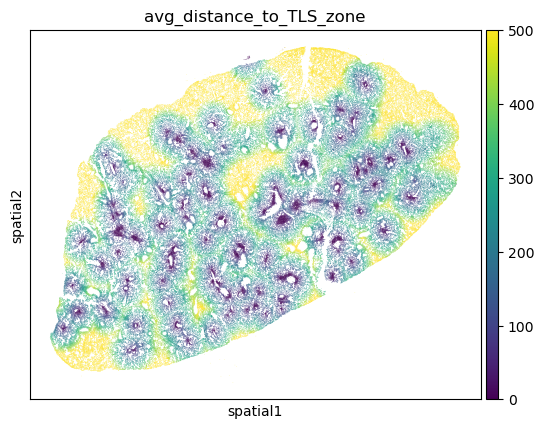

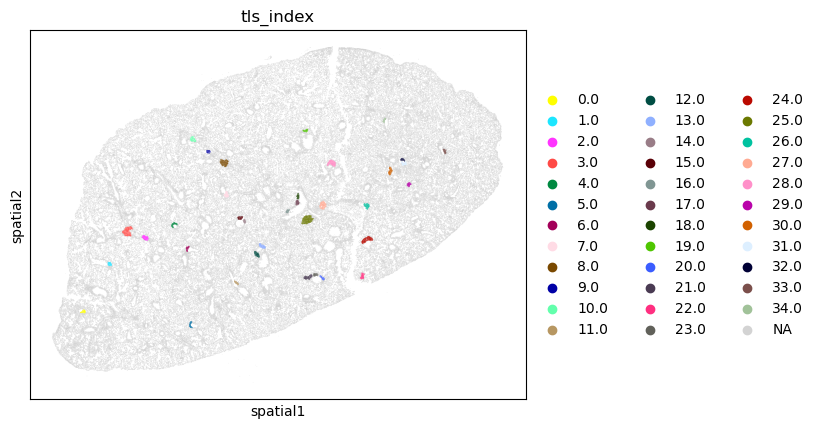

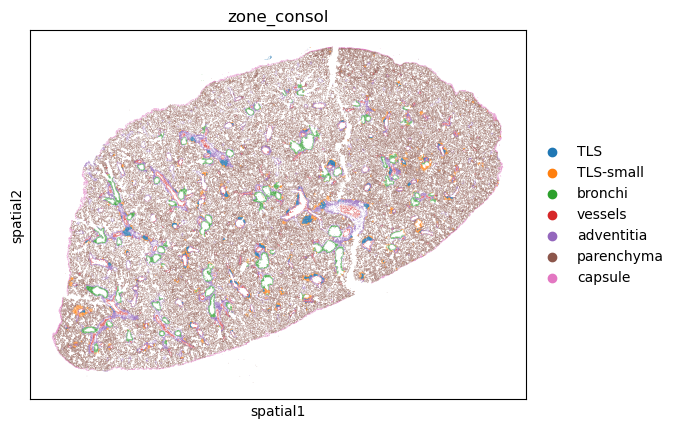

In [144]:
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'distance_to_tls', vmax = 500)
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'avg_distance_to_TLS_zone', vmax = 500)
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'tls_index')
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'zone_consol')

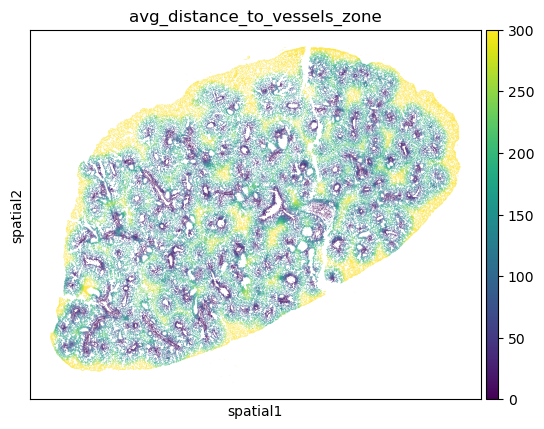

In [145]:
sc.pl.embedding(adata_d3, basis = 'spatial', color = 'avg_distance_to_vessels_zone', vmax = 300)


## Plot CD4 DE genes along distance axes (in CD4 act only)

#### Filter genes by those robustly expressed in CITE dataset and in Xenium datast (5% threshold in at least one subset):

In [149]:
# CITE genes expressed in 5% of at least one subset
gene_df = pd.read_csv('/home/workspace/spatial_mouse_lung_outputs/distance_analysis/ouputs_mouselung_xenseg_HDM/R/cite_expressed_genes_by_annotation.csv')
genes_cite_filt = gene_df['x'].tolist()

# Xenium genes expressed in 5% of at least one subset
genes_xen_filt = []
adata_cd4 = adata.copy()
for subset in adata_cd4.obs['label_fine'].unique().tolist():
    adata_cd4_subset = adata_cd4[adata_cd4.obs['label_fine'] == subset, :]
    adata_cd4_subset = filter_adata_expressed_in_n_cells(adata_cd4_subset, percent=0.05)
    genes_xen_filt.extend(adata_cd4_subset.var.index.tolist())
genes_xen_filt = list(set(genes_xen_filt))

# take the intersection and use this list for heatmaps 
genes_cite_xen_filt = list(set(genes_cite_filt) & set(genes_xen_filt))

In [150]:
genes_highlight_tls = ['Il21', 'Ccr7', 'Slamf6', 'Tcf7', 'Id3', 'Tbx21', 'Cxcr6', 'Il1rl1', 'Gata3', 'Il13', 'Calca']
genes_highlight_bronchi = ['Il1rl1', 'Il2ra', 'Foxp3', 'Gata3', 'Klrg1', 'Nmur1', 'Prdm1', 'Cxcr6', 'Id3', 'Slamf6', 'Tcf7', 'Tbx21', 'Ccr7']

HDM_day3
Creating Heatmap for sample labels  HDM_day3
Subset to 'label_medium'=='CD4 act'
adata shape:  (8658, 184)
clipping x to  450
Setting `n_convolve` to 1469 (5 bins, 7349 cells) 
HDM_day30
Creating Heatmap for sample labels  HDM_day30
Subset to 'label_medium'=='CD4 act'
adata shape:  (1828, 184)
clipping x to  450
Setting `n_convolve` to 157 (5 bins, 785 cells) 


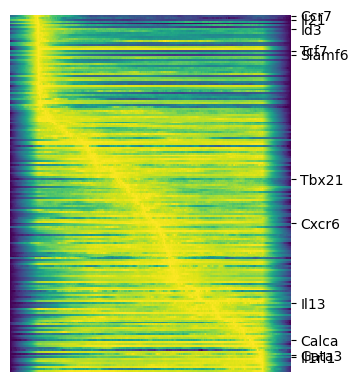

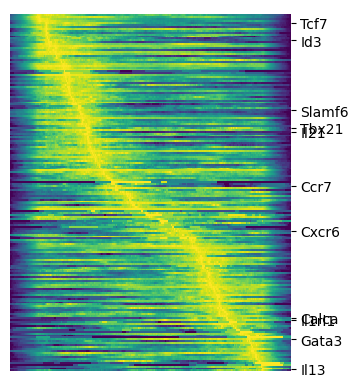

In [190]:
for sample_label in adata.obs['sample_label'].cat.categories:
    print(sample_label)
    adata_plot = adata[adata.obs['sample_label']==sample_label, :]
    s = scvelo_heatmap(
        adata_plot[:,genes_cite_xen_filt],
        sample_label=[sample_label],
        # sortby = 'distance_to_tls',
        sortby = 'avg_distance_to_TLS_zone',
        key_name = 'label_medium',
        key_value = 'CD4 act',
        highlight = genes_highlight_tls,
        x_clip = 450, 
        expression_threshold= None, # already using a filtered gene list 
        figsize=(4,4)
    )
    s
    plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_tls-zone_CD4.pdf"), dpi=300, bbox_inches='tight', transparent=True)

HDM_day3
Creating Heatmap for sample labels  HDM_day3
Subset to 'label_medium'=='CD4 act'
adata shape:  (8658, 184)
clipping x to  500
Setting `n_convolve` to 963 (5 bins, 4815 cells) 
HDM_day30
Creating Heatmap for sample labels  HDM_day30
Subset to 'label_medium'=='CD4 act'
adata shape:  (1828, 184)
clipping x to  500
Setting `n_convolve` to 96 (5 bins, 482 cells) 


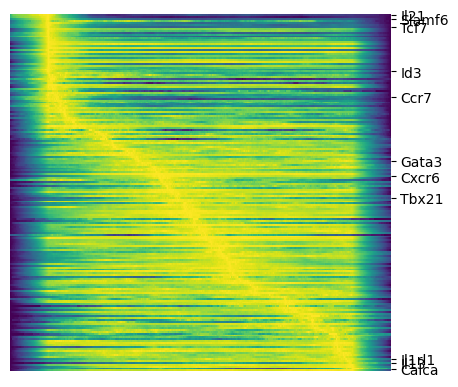

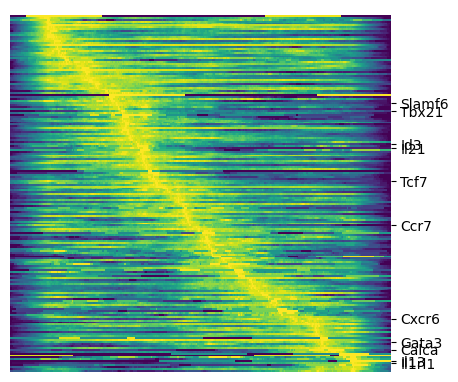

In [148]:
for sample_label in adata.obs['sample_label'].cat.categories:
    print(sample_label)
    adata_plot = adata[adata.obs['sample_label']==sample_label, :]
    s = scvelo_heatmap(
        adata_plot[:,genes_cite_xen_filt],
        sample_label=[sample_label],
        sortby = 'distance_to_tls',
        key_name = 'label_medium',
        key_value = 'CD4 act',
        highlight = genes_highlight_tls,
        x_clip = 500, 
        expression_threshold= None, # already using a filtered gene list 
        figsize=(5,4)
    )
    s
    plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_tls-structure_CD4.pdf"), dpi=300, bbox_inches='tight', transparent=True)

HDM_day3
Creating Heatmap for sample labels  HDM_day3
Subset to 'label_medium'=='CD4 act'
adata shape:  (8048, 184)
clipping x to  450
Setting `n_convolve` to 1270 (5 bins, 6352 cells) 
HDM_day30
Creating Heatmap for sample labels  HDM_day30
Subset to 'label_medium'=='CD4 act'
adata shape:  (1596, 184)
clipping x to  450
Setting `n_convolve` to 222 (5 bins, 1113 cells) 


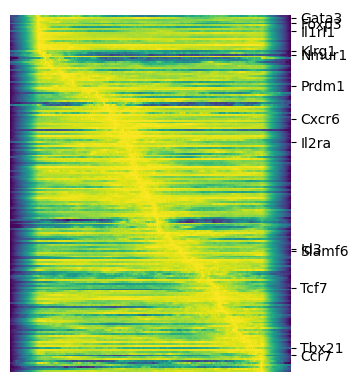

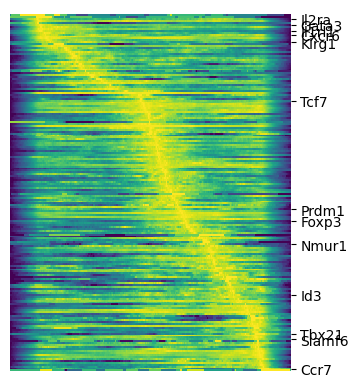

In [189]:
for sample_label in adata.obs['sample_label'].cat.categories:
    print(sample_label)
    adata_plot = adata[adata.obs['sample_label']==sample_label, :]
    s = scvelo_heatmap(
        adata_plot[~adata_plot.obs['zone_consol'].isin(['TLS']),genes_cite_xen_filt],
        sample_label=[sample_label],
        sortby = 'avg_distance_to_bronchi_zone',
        key_name = 'label_medium',
        key_value = 'CD4 act',
        highlight = genes_highlight_bronchi,
        x_clip = 450, 
        expression_threshold= None, # already using a filtered gene list 
        figsize=(4,4)
    )
    s
    plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_bronchi-zone_CD4.pdf"), dpi=300, bbox_inches='tight', transparent=True)

### Generate heatmaps showing all gene labels, just for day 3

HDM_day3
Creating Heatmap for sample labels  HDM_day3
Subset to 'label_medium'=='CD4 act'
adata shape:  (8658, 184)
clipping x to  500
Setting `n_convolve` to 1530 (5 bins, 7653 cells) 


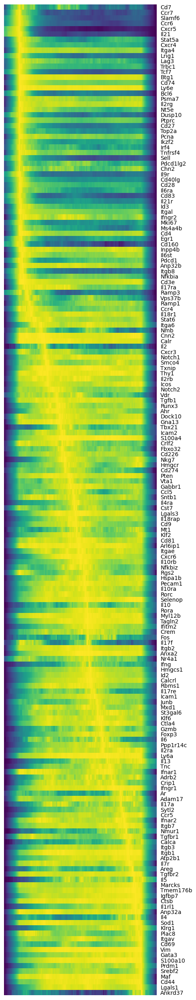

In [151]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
s = scvelo_heatmap(
    adata_plot[:,genes_cite_xen_filt],
    sample_label=[sample_label],
    # sortby = 'distance_to_tls',
    sortby = 'avg_distance_to_TLS_zone',
    key_name = 'label_medium',
    key_value = 'CD4 act',
    highlight = None,
    x_clip = 500, 
    expression_threshold= None, # already using a filtered gene list 
    figsize=(5,25)
)
# plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_tls-structure_CD4_showallgenes.pdf"), dpi=300, bbox_inches='tight', transparent=True)
plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_TLS-zone_CD4_showallgenes.pdf"), dpi=300, bbox_inches='tight', transparent=True)

HDM_day3
Creating Heatmap for sample labels  HDM_day3
Subset to 'label_medium'=='CD4 act'
adata shape:  (8048, 184)
clipping x to  500
Setting `n_convolve` to 1348 (5 bins, 6743 cells) 


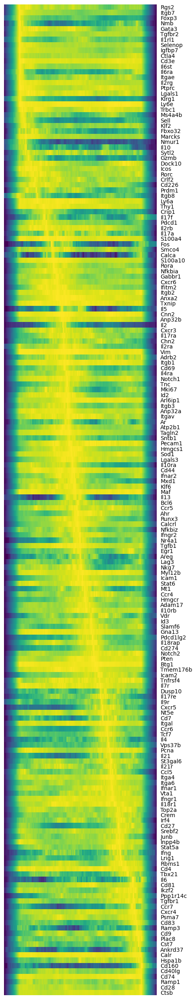

In [153]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
s = scvelo_heatmap(
    adata_plot[~adata_plot.obs['zone_consol'].isin(['TLS']),genes_cite_xen_filt],
    sample_label=[sample_label],
    sortby = 'avg_distance_to_bronchi_zone',
    key_name = 'label_medium',
    key_value = 'CD4 act',
    highlight = None,
    x_clip = 500, 
    expression_threshold= None, # already using a filtered gene list 
    figsize=(5,25)
)
plt.savefig(os.path.join(plot_out_dir, f"{sample_label}_scVelo_bronchi-zone_CD4_showallgenes.pdf"), dpi=300, bbox_inches='tight', transparent=True)

## Plot cytokine ligand DE genes along distance axes (in all cells)

In [154]:
df_kegg_cytokines = pd.read_csv("/home/workspace/spatial_tls_manuscript/inputs/kegg_cytokines.csv")
df_kegg_cytokines = df_kegg_cytokines[df_kegg_cytokines["type"] == "ligand"]

all_cyto_genes = df_kegg_cytokines['gene'].tolist()

cyto_genes_panel = list(set(all_cyto_genes) & set(adata_d3.var.index))
len(cyto_genes_panel)

41

### All cytokine ligands in panel 

Creating Heatmap for sample labels  HDM_day3
using all cells
removing genes by expression threshold:  0.05  %
adata shape:  (355812, 15)
clipping x to  500
Setting `n_convolve` to 36177 (5 bins, 180885 cells) 


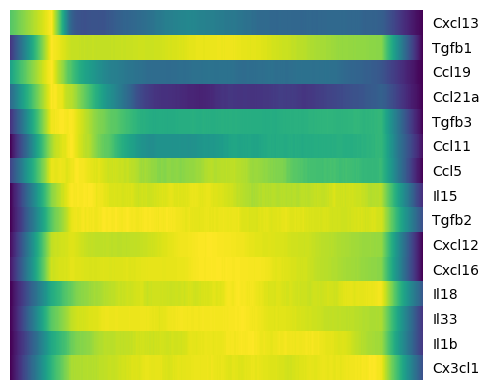

In [60]:
s = scvelo_heatmap(
    adata_d3[:,cyto_genes_panel],
    sample_label=['HDM_day3'],
    sortby = 'distance_to_tls',
    key_name = 'label_medium',
    key_value = None,
    highlight = None,
    x_clip = 500,
    expression_threshold= 0.05,
    figsize=(5,4)
)
s
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_scVelo_tls-structure_allcells_cyto.pdf"), dpi=300, bbox_inches='tight', transparent=True)

Creating Heatmap for sample labels  HDM_day3
using all cells
removing genes by expression threshold:  0.05  %
adata shape:  (346491, 14)
clipping x to  500
Setting `n_convolve` to 57020 (5 bins, 285102 cells) 


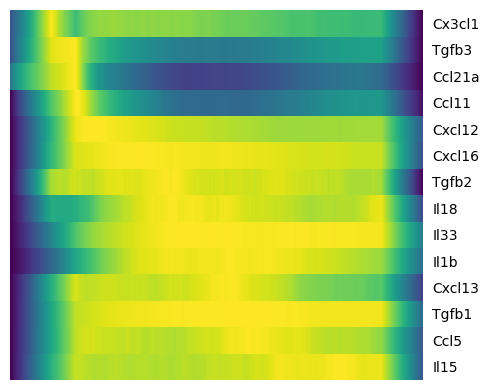

In [61]:
s = scvelo_heatmap(
    adata_d3[~adata_d3.obs['zone_consol'].isin(['TLS']),cyto_genes_panel],
    sample_label=['HDM_day3'],
    sortby = 'avg_distance_to_bronchi_zone',
    key_name = 'label_medium',
    key_value = None,
    highlight = None,
    x_clip = 500,
    expression_threshold= 0.05,
    figsize=(5,4)
)
s
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_scVelo_bronchi-zone_allcells_cyto_allgenesinpanel.pdf"), dpi=300, bbox_inches='tight', transparent=True)

Creating Heatmap for sample labels  HDM_day3
using all cells
removing genes by expression threshold:  0.05  %
adata shape:  (346491, 14)
clipping x to  500
Setting `n_convolve` to 68603 (5 bins, 343016 cells) 


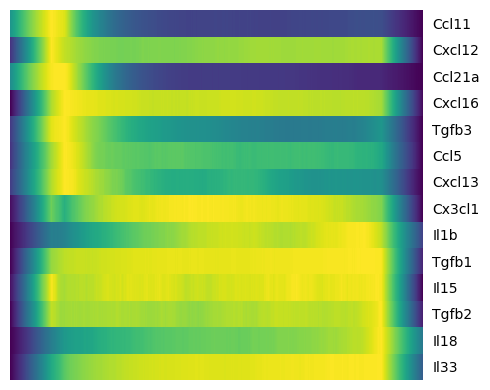

In [62]:
s = scvelo_heatmap(
    adata_d3[~adata_d3.obs['zone_consol'].isin(['TLS']),cyto_genes_panel],
    sample_label=['HDM_day3'],
    sortby = 'avg_distance_to_vessels_zone',
    key_name = 'label_medium',
    key_value = None,
    highlight = None,
    x_clip = 500,
    expression_threshold= 0.05,
    figsize=(5,4)
)
s
plt.savefig(os.path.join(plot_out_dir, "HDM_day3_scVelo_vessels-zone_allcells_cyto_allgenesinpanel.pdf"), dpi=300, bbox_inches='tight', transparent=True)

## 2D distance plots

In [16]:
def distance_xy(
    adata: sc.AnnData,
    sample_label: list[str],
    x_axis: str,
    y_axis: str,
    key_name: str,
    key_value: str = None,
    gene_name: str = None,
    signature_col: str = None,
    palette=None, 
    x_clip=None,
    y_clip=None,
    figsize: tuple = None,
    vline: float = None, 
    hline: float = None,
):

    # Subset by sample_label
    adata = adata[adata.obs["sample_label"].isin(sample_label)]
    
    if key_value:
        print(f"Subset to '{key_name}' == '{key_value}'")
        adata = adata[adata.obs[key_name] == key_value]
    else:
        print("Using all cells")

    # Clip x and y axes
    if x_clip:
        print('Clipping x to', x_clip)
        adata = adata[adata.obs[x_axis] <= x_clip, :]
    if y_clip:
        print('Clipping y to', y_clip)
        adata = adata[adata.obs[y_axis] <= y_clip, :]

    sub_adata = adata.copy()

    if signature_col:
        print('plotting signature')
        gene_expr = sub_adata.obs[signature_col]
        title = signature_col
    else:
        print('plotting gene expr')
        gene_expr = sub_adata[:, gene_name].X.toarray().flatten() if hasattr(sub_adata[:, gene_name].X, "toarray") else sub_adata[:, gene_name].X.flatten()
        gene_expr = np.nan_to_num(gene_expr)
        title = gene_name

     # add scatter plot here
    fig, ax = plt.subplots(figsize=(3, 3), dpi=200)

    # Add scatter plot colored by gene_expr
    sc = ax.scatter(
        adata.obs[x_axis],
        adata.obs[y_axis],
        c=gene_expr,
        cmap="viridis",
        s=5,
        linewidth=0,
    )
    # plt.colorbar(sc, ax=ax, label='Expression')

    # Add vline and hline if specified
    if vline is not None:
        ax.axvline(x=vline, color='gray', linestyle='--', linewidth=1)
    if hline is not None:
        ax.axhline(y=hline, color='gray', linestyle='--', linewidth=1)


    ax.set_xlim(-10,x_clip+10)
    ax.set_ylim(-10,y_clip+10)
    
        
    ax.set_xlabel(x_axis)
    ax.set_ylabel(y_axis)
    ax.grid(False)

    fig.tight_layout()
    plt.title(title)



In [42]:
from scipy.spatial import KDTree

def scatter_with_gaussian_kde(ax, x, y, weights=None, **kwargs):
    from scipy.stats import gaussian_kde

    xy = np.vstack([x, y])

    try:
        z = gaussian_kde(xy, weights=weights)(xy)
    except:
        z = gaussian_kde(xy)(xy)

    kwargs.setdefault('marker', '.')
    ax.scatter(x, y, c=z, **kwargs)

def distance_xy_kde(
    adata: sc.AnnData,
    sample_label: list[str],
    x_axis: str,
    y_axis: str,
    key_name: str,
    key_value: str = None,
    gene_name: str = None,
    signature_col: str = None, 
    palette=None, 
    x_clip=None,
    y_clip=None,
    figsize: tuple = None,
    vline: float = None, 
    hline: float = None,
    point_size = 2,
):

    fig = plt.figure(figsize=(3, 3), dpi=200)
    
    # Subset by sample_label
    adata = adata[adata.obs["sample_label"].isin(sample_label)]
    
    if key_value:
        print(f"Subset to '{key_name}' == '{key_value}'")
        adata = adata[adata.obs[key_name] == key_value]
    else:
        print("Using all cells")

    # Clip x and y axes
    if x_clip:
        print('Clipping x to', x_clip)
        adata = adata[adata.obs[x_axis] <= x_clip, :]
    if y_clip:
        print('Clipping y to', y_clip)
        adata = adata[adata.obs[y_axis] <= y_clip, :]

    sub_adata = adata.copy()

    if signature_col:
        print('plotting signature')
        gene_expr = sub_adata.obs[signature_col]
        title = signature_col
    else:
        print('plotting gene expr')
        gene_expr = sub_adata[:, gene_name].X.toarray().flatten() if hasattr(sub_adata[:, gene_name].X, "toarray") else sub_adata[:, gene_name].X.flatten()
        gene_expr = np.nan_to_num(gene_expr)
        title = gene_name
    
    ax = fig.add_subplot(1, 1, 1)
    
     
    # KDE scatter plot
    scatter_with_gaussian_kde(
        ax=ax,
        x=sub_adata.obs[x_axis],
        y=sub_adata.obs[y_axis],
        s=point_size,
        weights=(gene_expr - np.min(gene_expr)) ** 2,
        cmap="viridis",
    )

    # KDE weighted by expression
    sns.kdeplot(
        data=sub_adata.obs,
        x=x_axis,
        y=y_axis,
        ax=ax,
        color="#444444",
        linewidths=1,
        weights=(gene_expr - np.min(gene_expr)) ** 2,
        cmap="viridis",
    )

    # Add vline and hline if specified
    if vline is not None:
        # ax.axvline(x=vline, color='black', linestyle='--', linewidth=2)
        ax.plot([vline, vline], [hline, y_clip], color='black', linestyle='--', linewidth=2)
    if hline is not None:
        ax.axhline(y=hline, color='black', linestyle='--', linewidth=2)


    ax.set_xlim(-10,x_clip+10)
    ax.set_ylim(-10,y_clip+10)
    
    ax.set_xticks([0, x_clip])
    ax.set_yticks([0, y_clip])
    ax.set_xticklabels(['0', str(x_clip)], fontsize=16)
    ax.set_yticklabels(['0', str(y_clip)], fontsize=16)    
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.grid(False)

    fig.tight_layout()
    plt.title(title, fontsize=20)
    
    return(plt)


HDM_day3
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipp

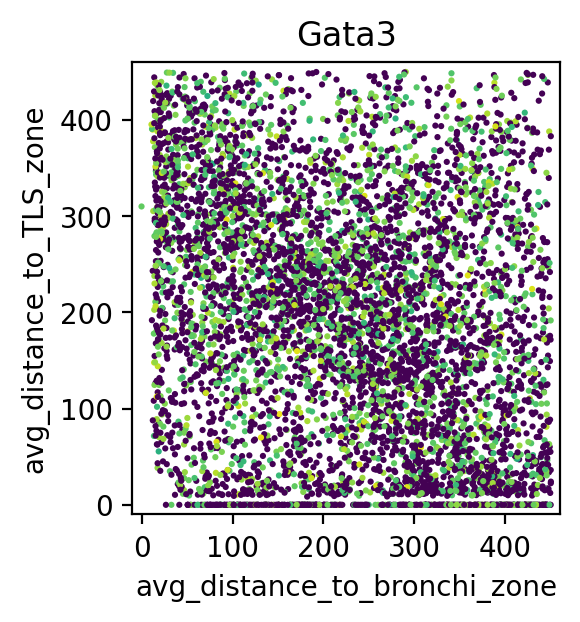

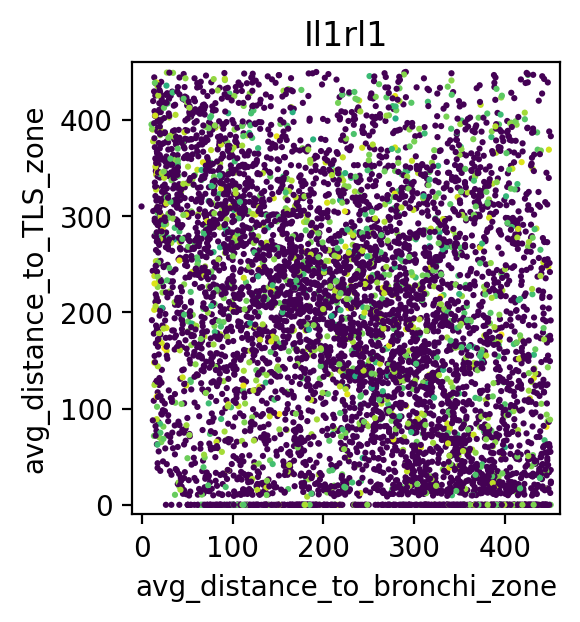

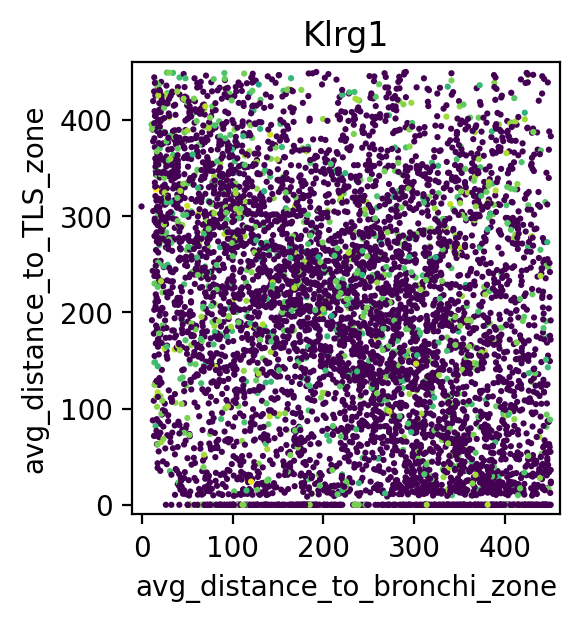

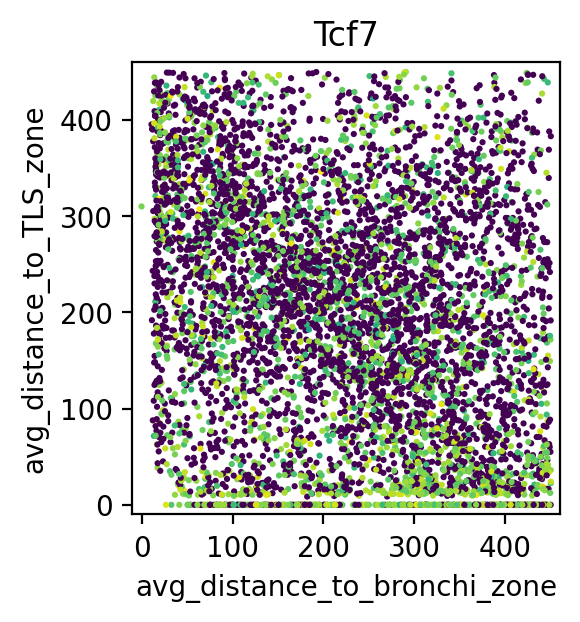

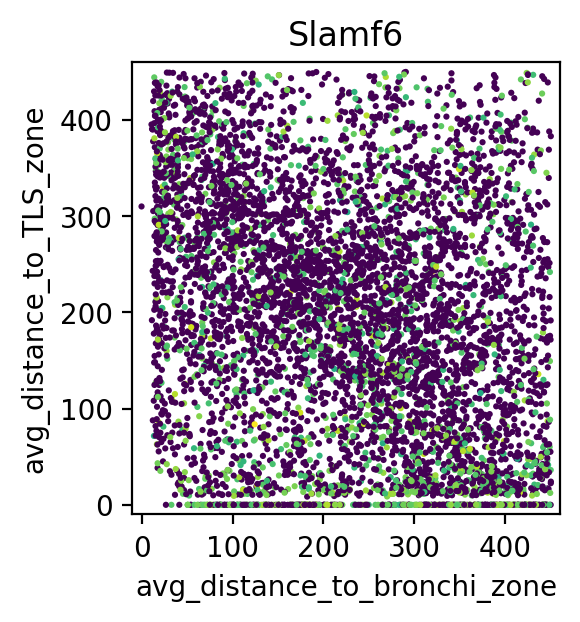

...

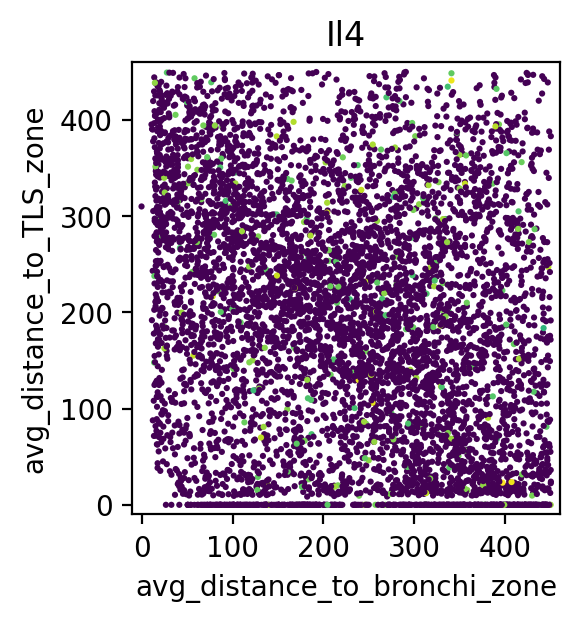

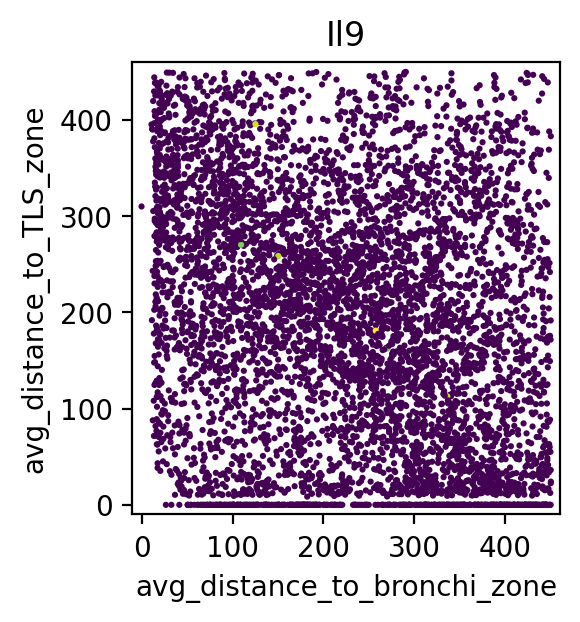

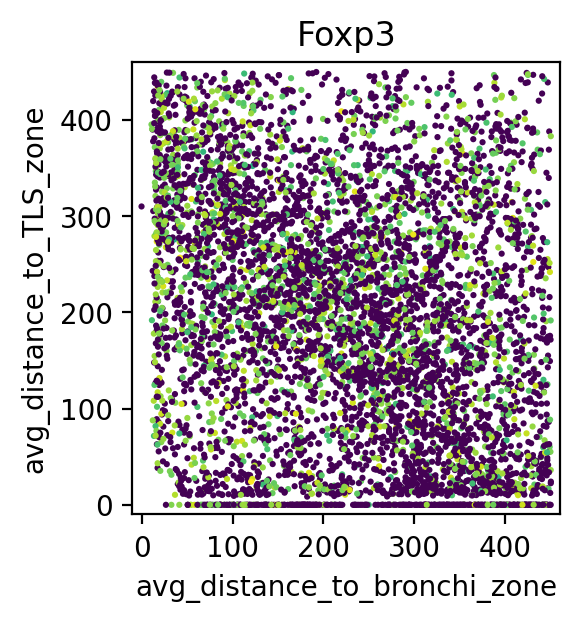

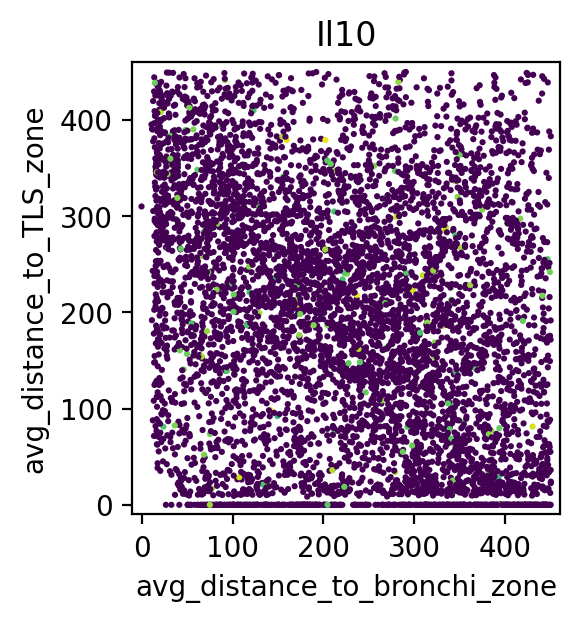

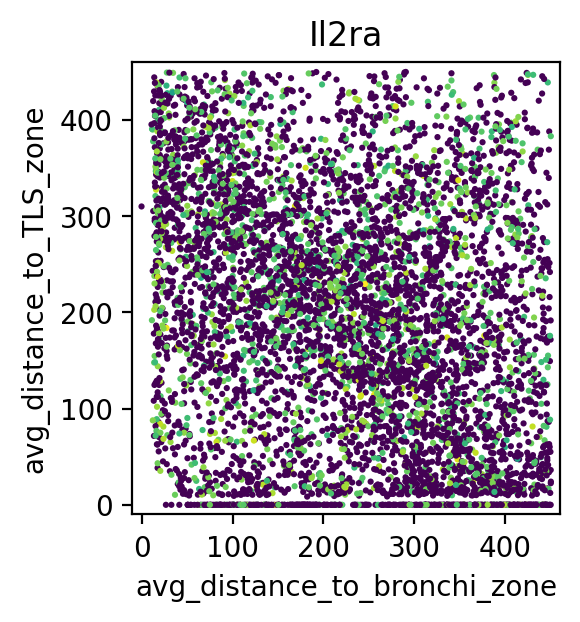

In [30]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
for gene_name in ['Gata3', 'Il1rl1', 'Klrg1',
                  'Tcf7', 'Slamf6', 'Ccr7',
                  'Il13', 'Il5', 'Il4','Il9',
                  'Foxp3', 'Il10', 'Il2ra'
                 ]:
    p = distance_xy(adata_plot,
                    sample_label=[sample_label],
                    x_axis = 'avg_distance_to_bronchi_zone',
                    y_axis = 'avg_distance_to_TLS_zone',
                    key_name = 'label_medium',
                    key_value = 'CD4 act',
                    gene_name = gene_name,
                    signature_col=None,
                   x_clip = 450,
                   y_clip= 450)
    p

HDM_day3
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipping y to 450
plotting gene expr
Subset to 'label_medium' == 'CD4 act'
Clipping x to 450
Clipp

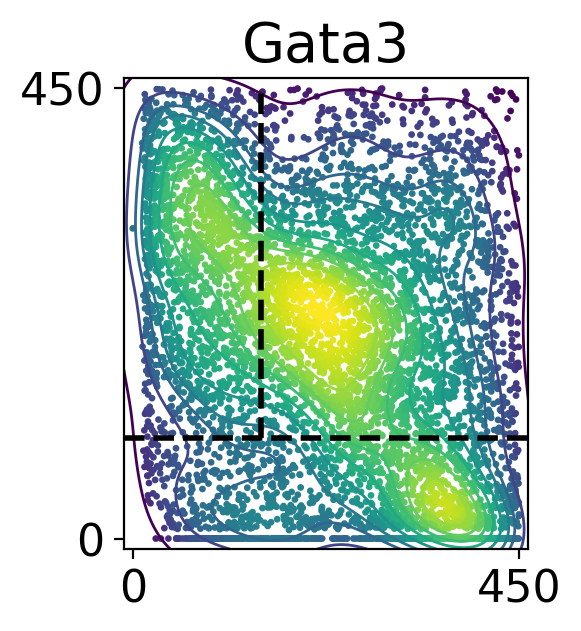

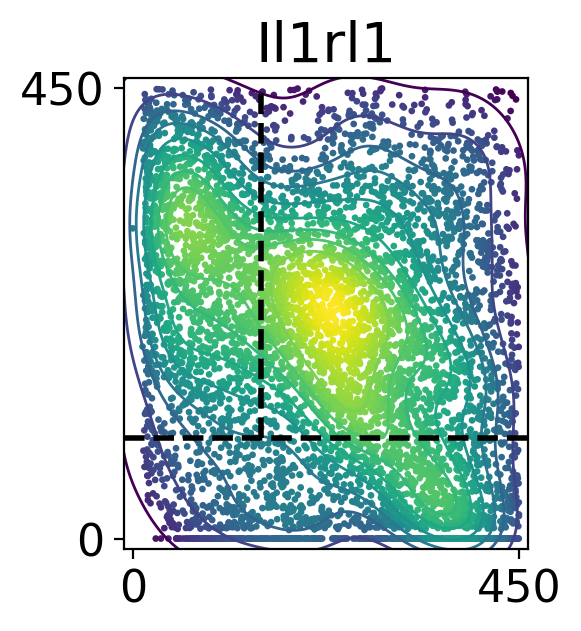

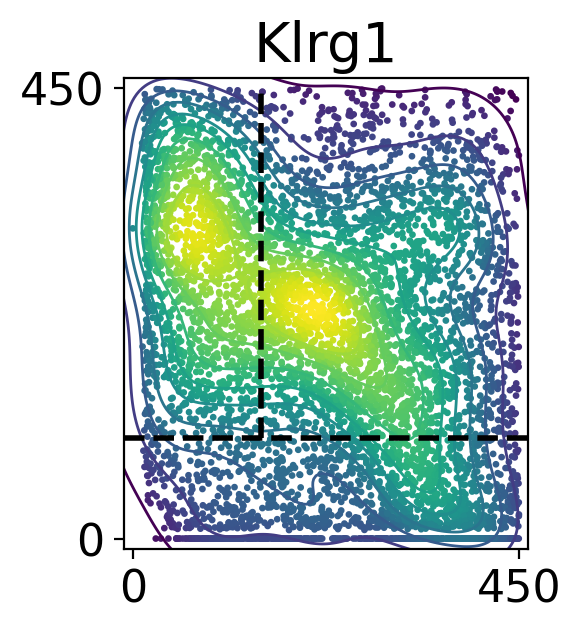

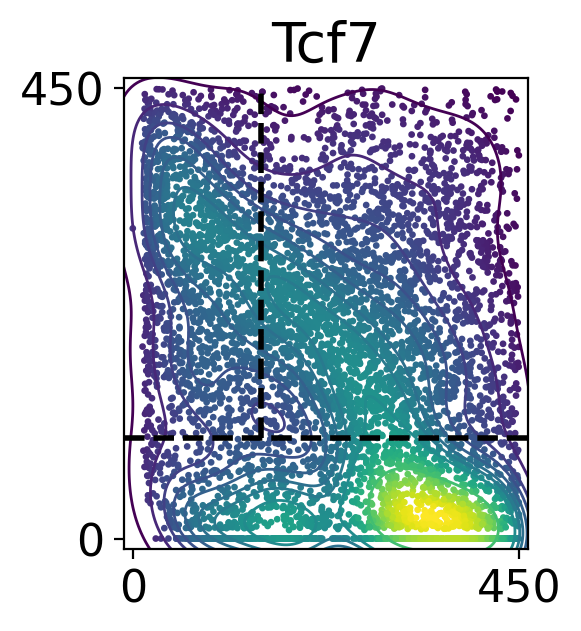

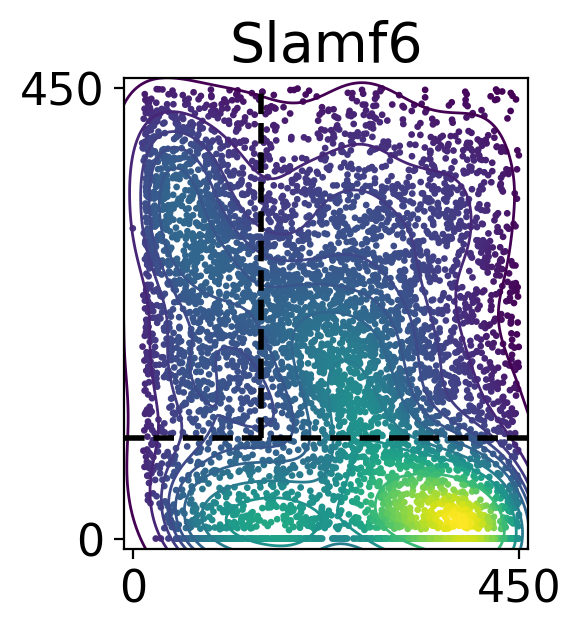

...

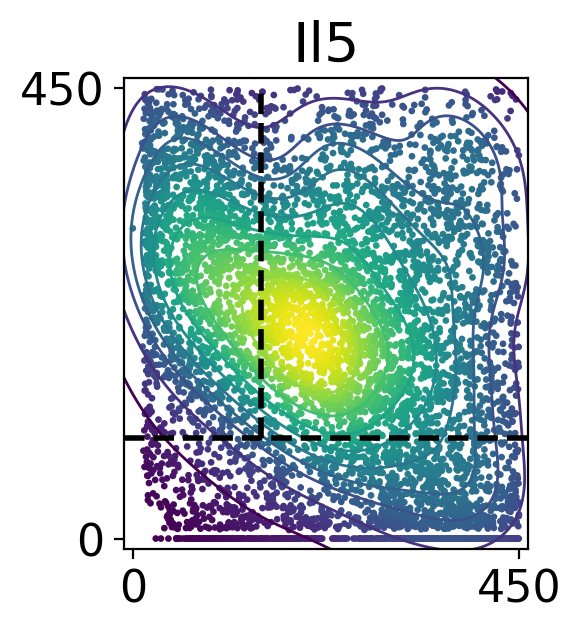

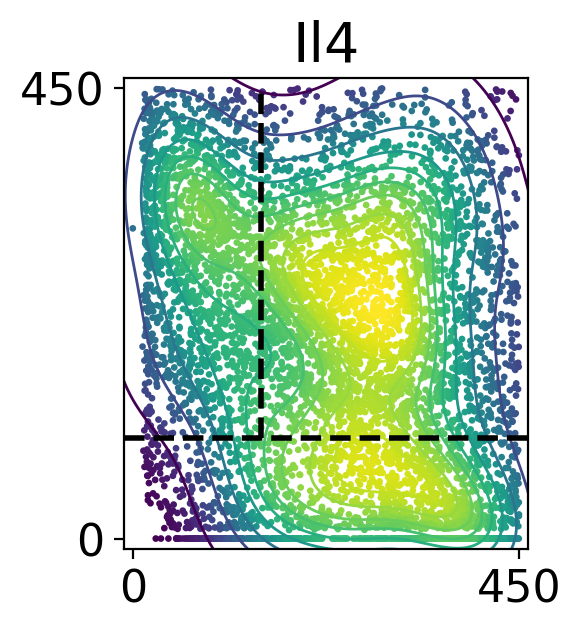

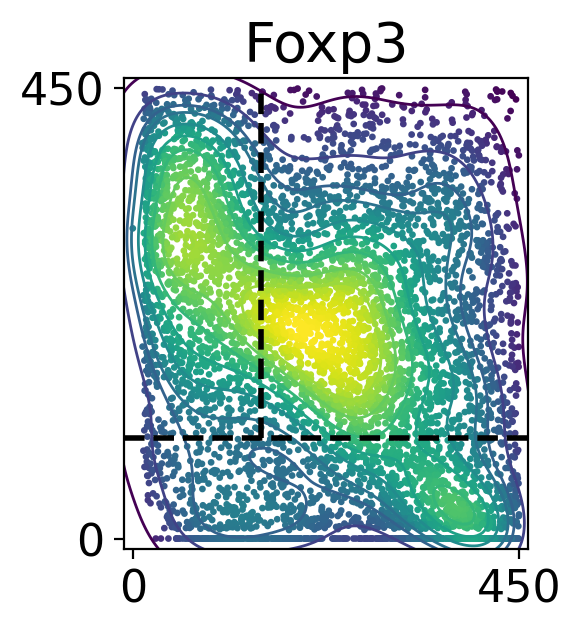

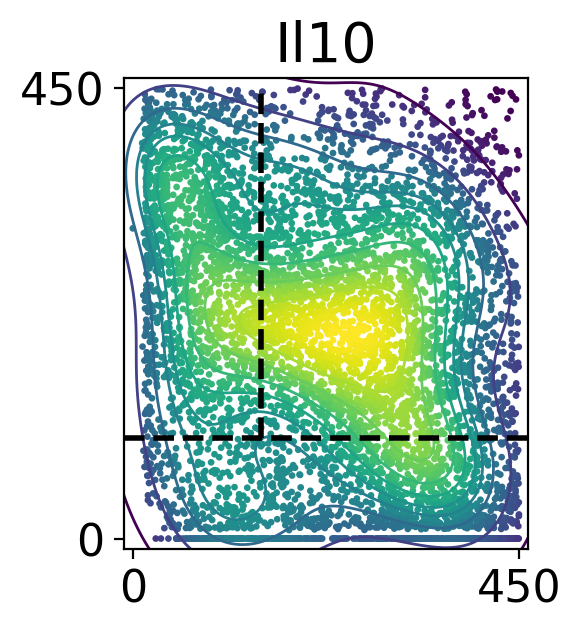

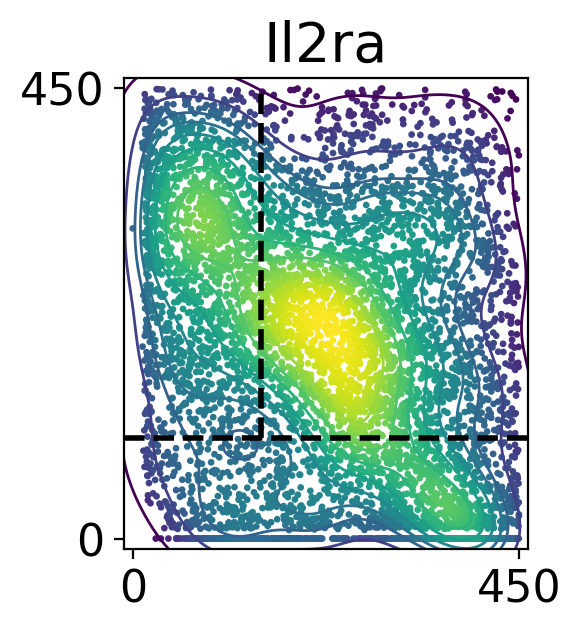

In [29]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
for gene_name in ['Gata3', 'Il1rl1', 'Klrg1',
                  'Tcf7', 'Slamf6', 'Ccr7',
                  'Il13', 'Il5', 'Il4',
                  'Foxp3', 'Il10', 'Il2ra'
                 ]:
    p = distance_xy_kde(adata_plot,
                    sample_label=[sample_label],
                    x_axis = 'avg_distance_to_bronchi_zone',
                        y_axis = 'avg_distance_to_TLS_zone',
                        gene_name = gene_name,
                    key_name = 'label_medium',
                    key_value = 'CD4 act',
                   x_clip = 450,
                   y_clip= 450,
                        vline = 150, hline = 100
                       )
    plt.savefig(os.path.join(plot_out_dir, f"2D_{gene_name}.pdf"), dpi=300, bbox_inches='tight', transparent=True)


### Distance quadrant gene expression heatmap

In [39]:
def quantify_quadrant_expression(adata, 
                                 x_axis = 'avg_distance_to_bronchi_zone',
                                 # y_axis = 'distance_to_tls',
                                 y_axis = 'avg_distance_to_TLS_zone',
                                 x_clip = 450, y_clip = 450,
                                 # x_clip=None, y_clip=None,
                                 x_threshold = 150, y_threshold = 100):
    
    adata = adata.copy()

    # Clip x and y axes
    if x_clip:
        print('Clipping x to', x_clip)
        adata = adata[adata.obs[x_axis] <= x_clip, :]
    if y_clip:
        print('Clipping y to', y_clip)
        adata = adata[adata.obs[y_axis] <= y_clip, :]
        
    quadrant_order = ['near-bronchi (B)', 'parenchyma (P)', 'near-TLS (T)']
    adata.obs['spatial_quadrant']= 'none'
    adata.obs.loc[(adata.obs[x_axis] > x_threshold) & (adata.obs[y_axis] > y_threshold), 'spatial_quadrant'] = 'parenchyma (P)'
    adata.obs.loc[adata.obs[y_axis] < y_threshold, 'spatial_quadrant'] = 'near-TLS (T)'
    adata.obs.loc[(adata.obs[x_axis] < x_threshold) & (adata.obs[y_axis] > y_threshold), 'spatial_quadrant'] = 'near-bronchi (B)'
    adata.obs['spatial_quadrant'] = pd.Categorical(adata.obs['spatial_quadrant'], categories=quadrant_order, ordered=True)
    return(adata) 

HDM_day3
Clipping x to 450
Clipping y to 450
(6202, 480)


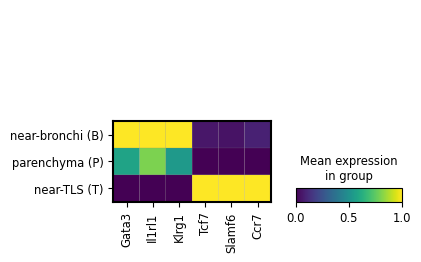

In [33]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
adata_plot = adata_plot[adata_plot.obs['label_medium']=='CD4 act', :]

adata_plot = quantify_quadrant_expression(adata_plot)

print(adata_plot.shape)
sc.pl.matrixplot(adata_plot, var_names=['Gata3', 'Il1rl1', 'Klrg1', 'Tcf7', 'Slamf6', 'Ccr7'], groupby='spatial_quadrant', 
                 standard_scale='var', 
                 show=False
                )
plt.savefig(os.path.join(plot_out_dir, "spatial_quadrant_gene_matrixplot.pdf"), dpi=300, bbox_inches='tight', transparent=True)

## Plot zones and distance in space

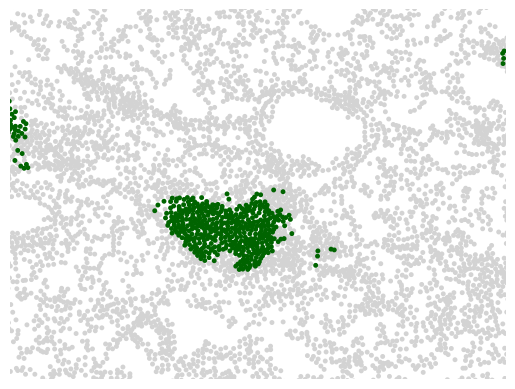

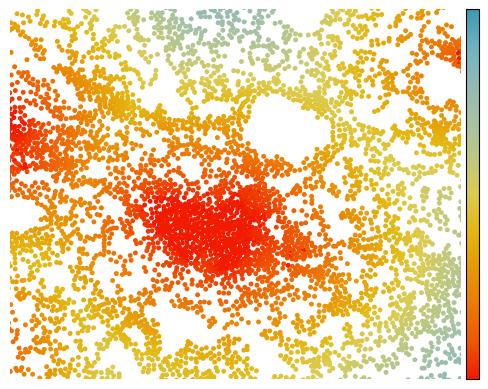

In [35]:
sample_label = 'HDM_day3'
adata_plot = adata_d3.copy()
adata_plot.obs['zone_consol_temp'] = adata_plot.obs['zone_consol'].copy()
adata_plot.obs.loc[adata_plot.obs['zone_consol'] != 'TLS', 'zone_consol_temp'] = np.nan
sc.pl.embedding(adata_plot, basis='spatial', color='zone_consol_temp',
                palette = zone_consol_palette_mapped,
                frameon=False, 
                size=50, 
                title = '',
                legend_loc = 'none',
                show=False)
   
plt.xlim([3700, 4400])
plt.ylim([4200, 4900])
plt.savefig(os.path.join(plot_out_dir, "zone_day3_tls_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

fig = sc.pl.embedding(adata_d3, basis='spatial', 
                color='avg_distance_to_TLS_zone',
                cmap = colormap_r,
                vmax=450,
                frameon=False, 
                size=50, 
                title = '',
                show=False, return_fig=True)

for ax in fig.axes:
    if ax.get_label() == '<colorbar>':  
        ax.set_yticks([])
        ax.set_yticklabels([])
        
plt.xlim([3700, 4400])
plt.ylim([4200, 4900])
plt.savefig(os.path.join(plot_out_dir, "distance_day3_tls_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

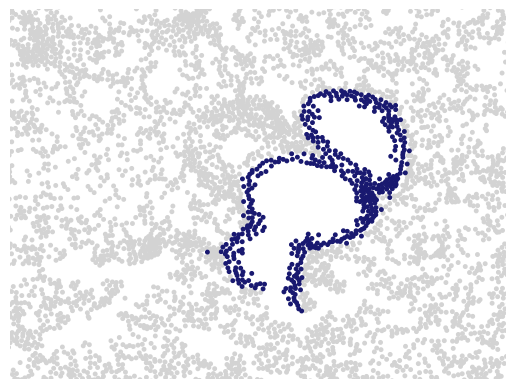

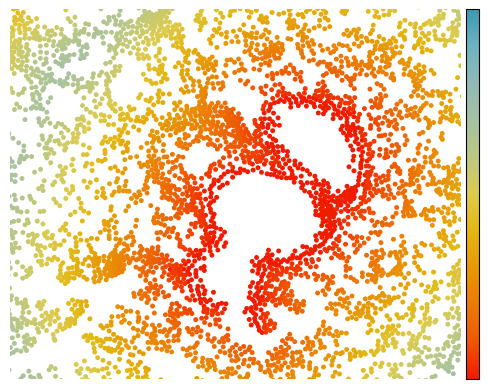

In [38]:
adata_plot = adata_d3.copy()
adata_plot.obs['zone_consol_temp'] = adata_plot.obs['zone_consol'].copy()
adata_plot.obs.loc[adata_plot.obs['zone_consol'] != 'bronchi', 'zone_consol_temp'] = np.nan
sc.pl.embedding(adata_plot, basis='spatial', color='zone_consol_temp',
                palette = zone_consol_palette_mapped,
                frameon=False, 
                size=50, 
                title = '',
                legend_loc = 'none',
                show=False)
    
plt.xlim([3150, 3900])
plt.ylim([2850, 3600])
plt.savefig(os.path.join(plot_out_dir, "zone_day3_bronchi_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

fig = sc.pl.embedding(adata_d3, basis='spatial', color='avg_distance_to_bronchi_zone',
                cmap = colormap_r,
                vmax=450,
                frameon=False, 
                size=50, 
                title = '',
                show=False, return_fig=True)

for ax in fig.axes:
    if ax.get_label() == '<colorbar>':  # scanpy marks colorbars this way
        ax.set_yticks([])
        ax.set_yticklabels([])
    
plt.xlim([3200, 3900])
plt.ylim([2900, 3600])
plt.savefig(os.path.join(plot_out_dir, "distance_day3_bronchi_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

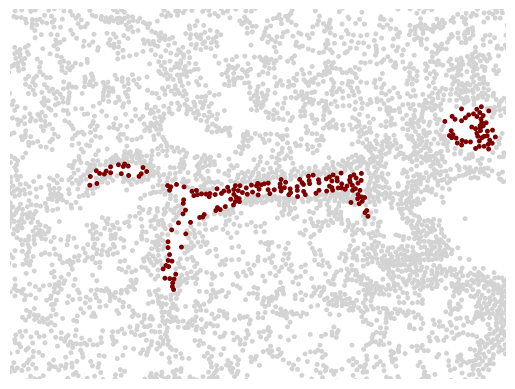

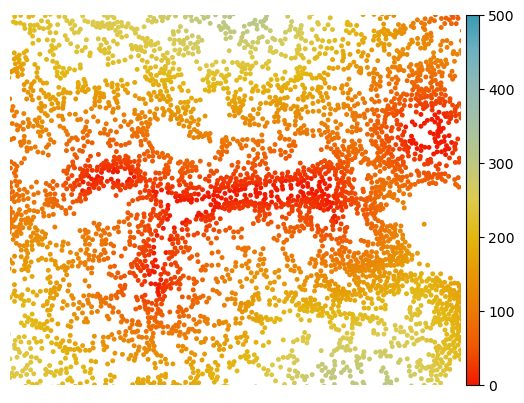

In [73]:
adata_plot = adata_d3.copy()
adata_plot.obs['zone_consol_temp'] = adata_plot.obs['zone_consol'].copy()
adata_plot.obs.loc[adata_plot.obs['zone_consol'] != 'vessels', 'zone_consol_temp'] = np.nan
sc.pl.embedding(adata_plot, basis='spatial', color='zone_consol_temp',
                palette = zone_consol_palette_mapped,
                frameon=False, 
                size=50, 
                title = '',
                legend_loc = 'none',
                show=False)
    
plt.xlim([4100, 4800])
plt.ylim([3500, 4200])
plt.savefig(os.path.join(plot_out_dir, "zone_day3_vessels_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

sc.pl.embedding(adata_d3, basis='spatial', color='avg_distance_to_vessels_zone',
                cmap = colormap_r,
                vmax=500,
                frameon=False, 
                size=50, 
                title = '',
                show=False)
    
plt.xlim([4100, 4800])
plt.ylim([3500, 4200])
plt.savefig(os.path.join(plot_out_dir, "distance_day3_vessels_zoom.png"), dpi=300, bbox_inches='tight', transparent=True)

## Plot 2D distances - ligand expression in all cells

HDM_day3
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr


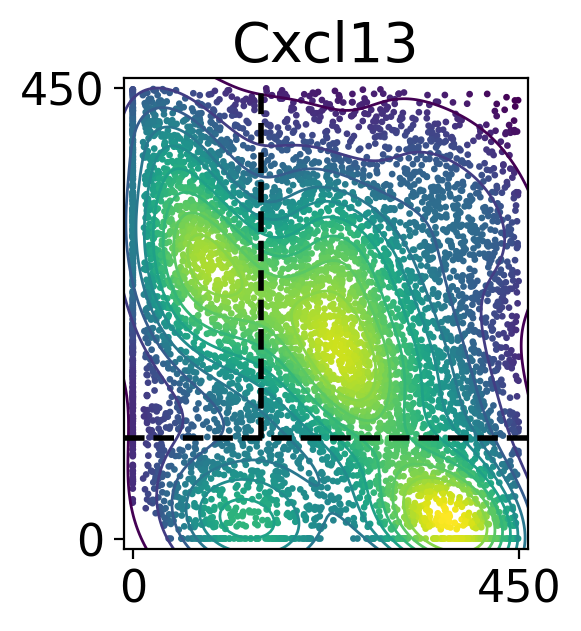

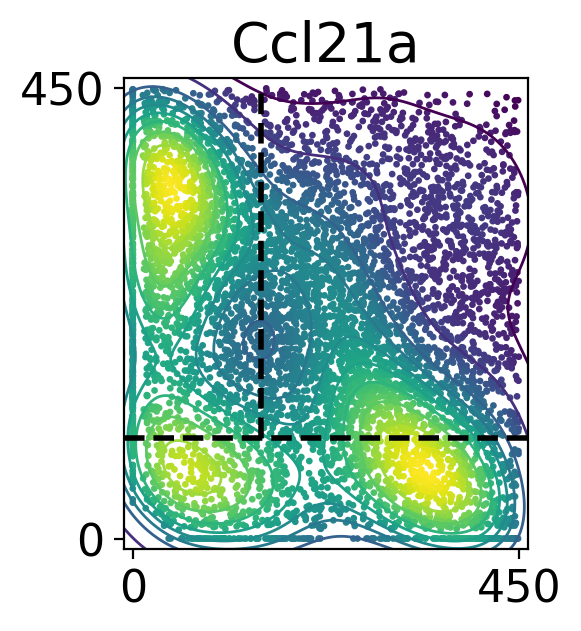

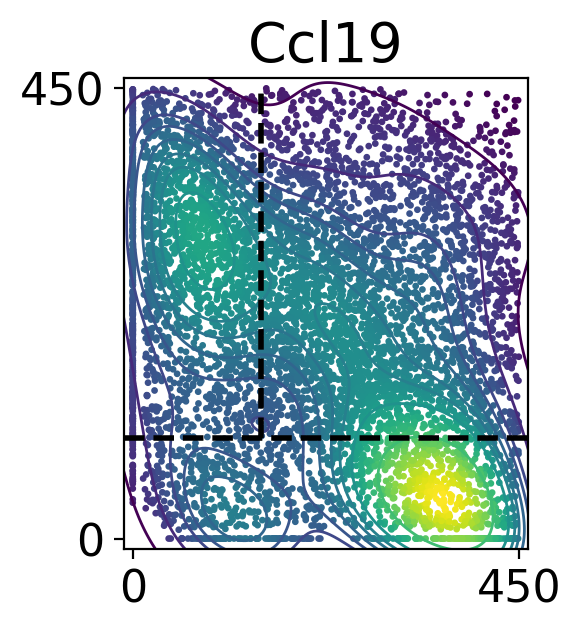

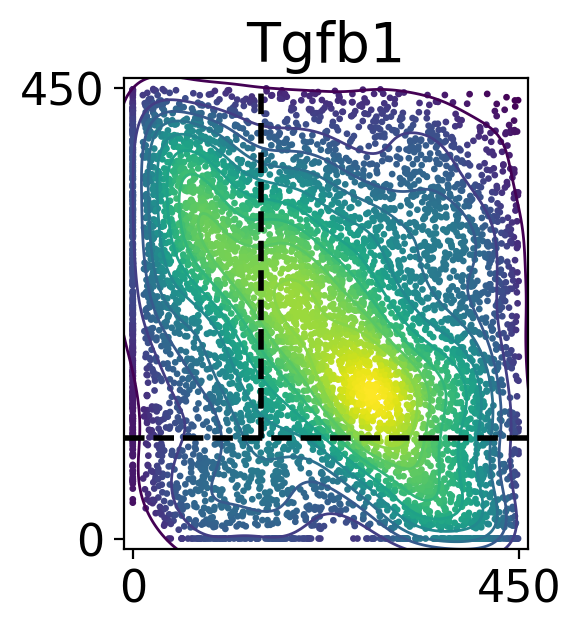

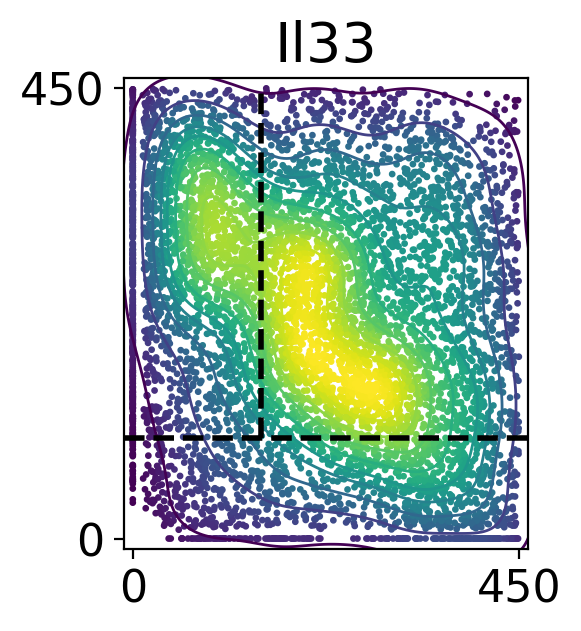

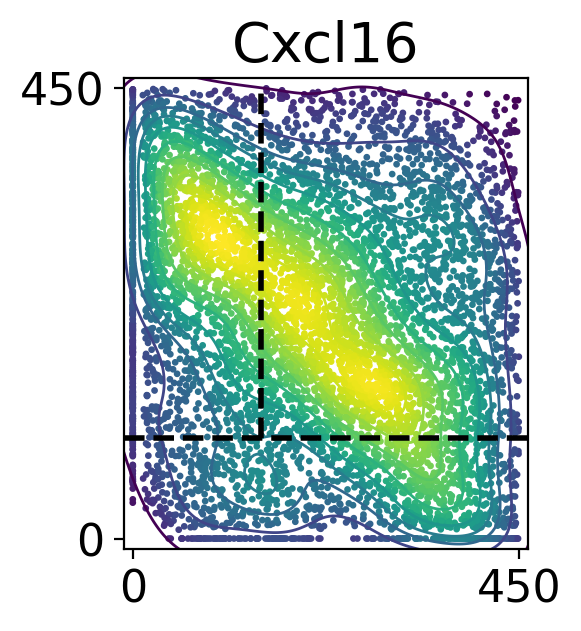

In [18]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
adata_plot = sc.pp.subsample(adata_plot, n_obs=10000, copy=True)
for gene_name in ['Cxcl13', 'Ccl21a','Ccl19', 
                  'Tgfb1', 'Il33', 
                  'Cxcl16'
                 ]:
    p = distance_xy_kde(adata_plot,
                    sample_label=[sample_label],
                    x_axis = 'avg_distance_to_bronchi_zone',
                        y_axis = 'avg_distance_to_TLS_zone',
                        gene_name = gene_name,
                    key_name = 'label_medium',
                    key_value = None,
                   x_clip = 450,
                   y_clip= 450,
                        vline = 150, hline = 100
                       )
    p
    plt.savefig(os.path.join(plot_out_dir, f"2D_{gene_name}_allcells_cyto.pdf"), dpi=300, bbox_inches='tight', transparent=True)


HDM_day3
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
0.94 minutes


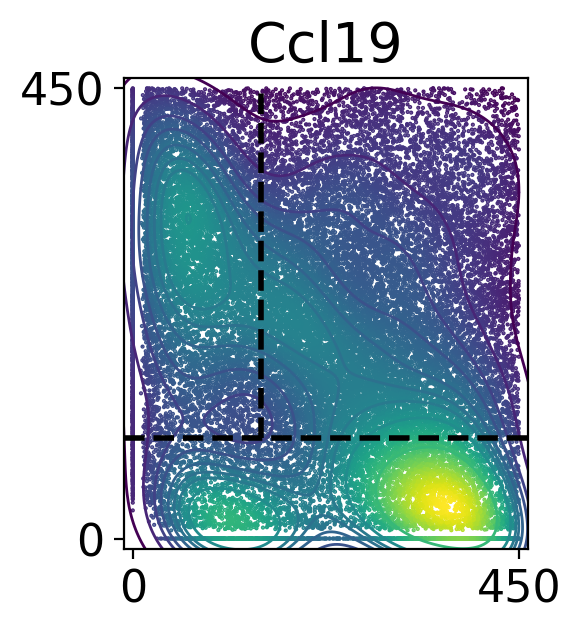

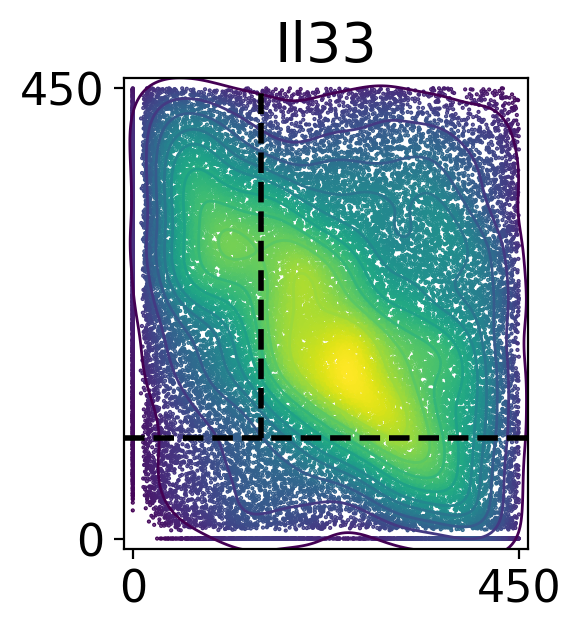

In [57]:
# Run on larger number of cells - this will take awhile

import time

start = time.time()

sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
adata_plot = sc.pp.subsample(adata_plot, n_obs=50000, copy=True)
for gene_name in ['Ccl19',
                  'Il33']:
    p = distance_xy_kde(adata_plot,
                    sample_label=[sample_label],
                    x_axis = 'avg_distance_to_bronchi_zone',
                        y_axis = 'avg_distance_to_TLS_zone',
                        gene_name = gene_name,
                    key_name = 'label_medium',
                    key_value = None,
                   x_clip = 450,
                   y_clip= 450,
                        vline = 150, hline = 100,
                        point_size = 1
                       )
    # p
    p.savefig(os.path.join(plot_out_dir, f"2D_{gene_name}_allcells_cyto_50k_{sample_label}.pdf"), dpi=300, bbox_inches='tight', transparent=True)



end = time.time()
duration = (end - start) / 60
print(f"{duration:.2f} minutes")

HDM_day3
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr
Using all cells
Clipping x to 450
Clipping y to 450
plotting gene expr


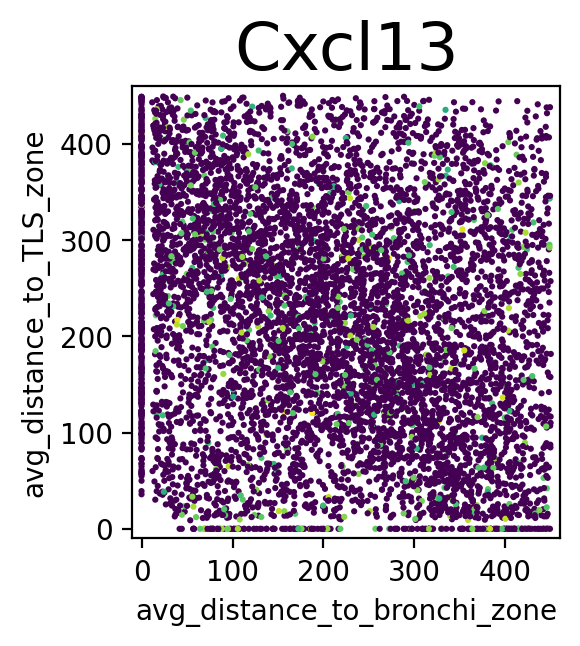

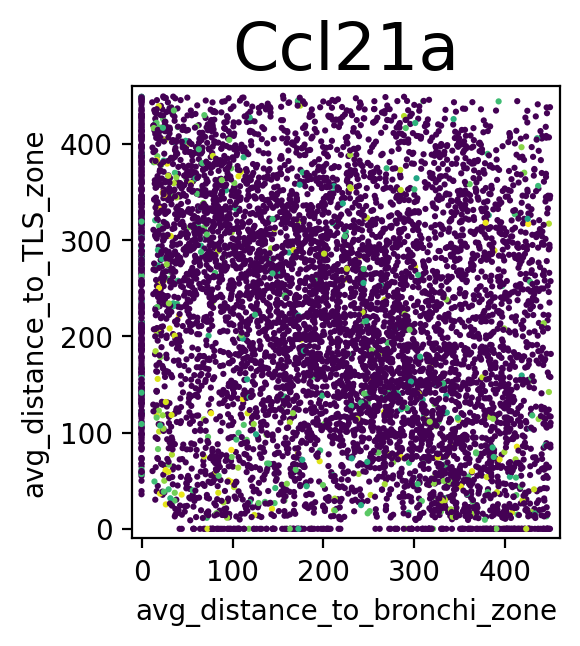

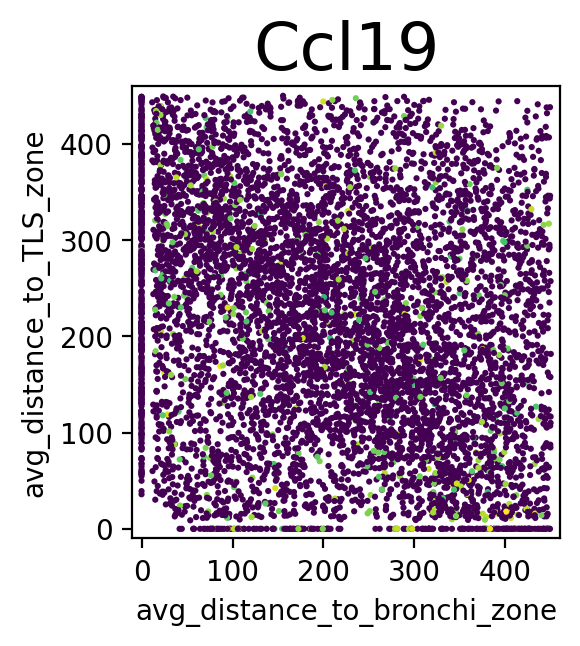

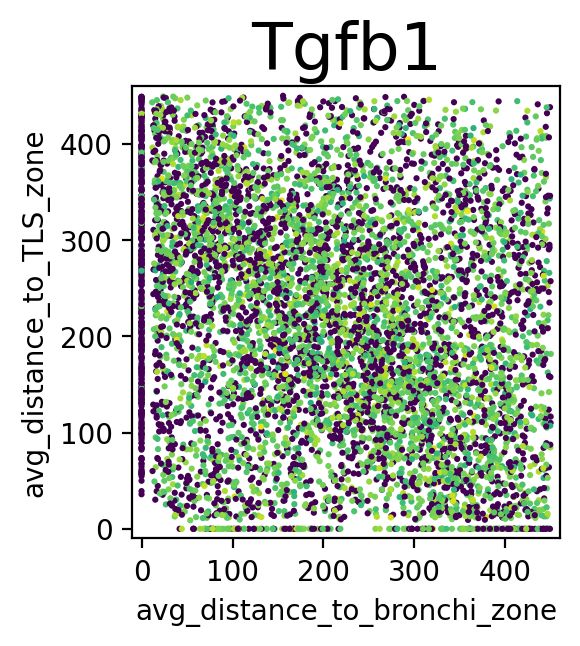

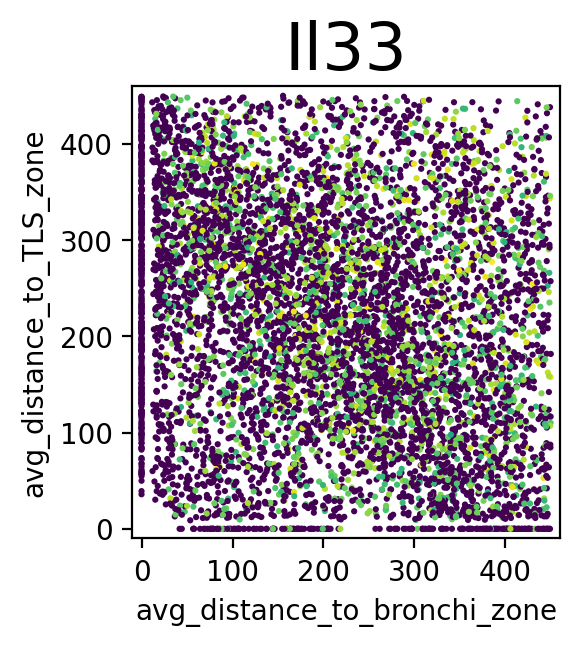

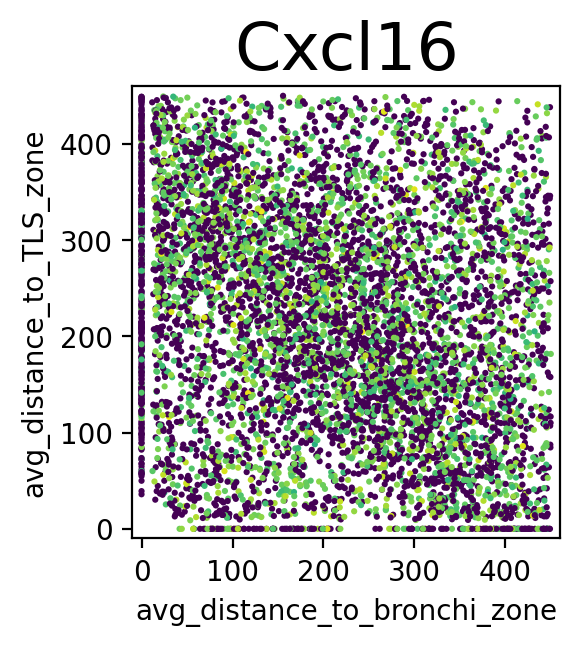

In [16]:
sample_label = 'HDM_day3'
print(sample_label)
adata_plot = adata[adata.obs['sample_label']==sample_label, :]
adata_plot = sc.pp.subsample(adata_plot, n_obs=10000, copy=True)
for gene_name in ['Cxcl13', 'Ccl21a','Ccl19', 
                  'Tgfb1', 'Il33', 
                  'Cxcl16'
                 ]:

    p = distance_xy(adata_plot,
                    sample_label=[sample_label],
                    x_axis = 'avg_distance_to_bronchi_zone',
                    y_axis = 'avg_distance_to_TLS_zone',
                    key_name = 'label_medium',
                    key_value = None,
                    gene_name = gene_name,
                    signature_col=None,
                   x_clip = 450,
                   y_clip= 450)
    p

### Check which cells are expressing these ligands

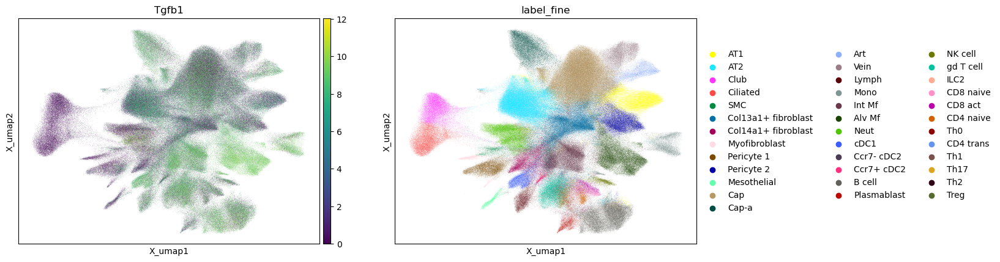

In [36]:
sc.pl.embedding(adata, basis = 'X_umap', color=['Tgfb1','label_fine'])

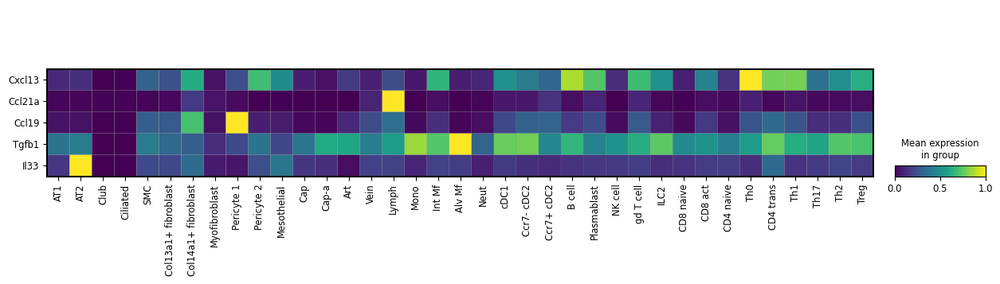

In [49]:
sc.pl.matrixplot(adata, var_names = ['Cxcl13', 'Ccl21a','Ccl19', 'Tgfb1', 'Il33'], groupby='label_fine', standard_scale = 'var', swap_axes=True)